**Temat:** Klasyfikacja zadowolenia klientów linii
lotniczych za pomocą różnych algorytmów
uczenia maszynowego

**Zbiór danych:** Airline Passenger Satisfaction (Kaggle) -- predykcja zadowolenia klientów linii lotniczych.

**Autorzy:** Jakub Kuczmarski (nr indksu: 297300) i Jan Kwiatkowski (nr indeksu: 299374)

# 0. Import i instalacja bibliotek

In [ ]:
pip install opendatasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install pandas_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.3/352.3 kB 30.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 14.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 52.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 38.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 70.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=fd9fb5cb88352c63d92fbf42faa98e05b8dbb9937b1367daca9725e58e51c66d
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attemp

In [ ]:
import pandas as pd

pd.set_option('display.max_columns', None) # wyświetlania wszystkich kolumn dla obiektów DataFrame z biblioteki pandas

import pandas_profiling
import numpy as np
import matplotlib.pyplot as plt
import opendatasets as od
import scipy
import matplotlib.pyplot as plt
import matplotlib

matplotlib.rcParams['figure.figsize'] = (15, 7) # ustawia domyślne wielkości wizualizacji wykresów

import seaborn as sns

sns.set() # ustawia domyślne stylizacje wykresów dla biblioteki seaborn

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score, KFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score

<ipython-input-3-d5c7c65b43cb>:5: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


# 1. Wczytanie danych

In [ ]:
# Pobranie danych z Kaggle
od.download("https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: kwiatek9
Your Kaggle Key: ··········


100%|██████████| 2.71M/2.71M [00:00<00:00, 92.4MB/s]

In [ ]:
# Wczytanie danych treningowych i testowych
train_data = pd.read_csv('airline-passenger-satisfaction/train.csv')
test_data = pd.read_csv('airline-passenger-satisfaction/test.csv')

In [ ]:
# Kształt zbioru treningowego i uczącego
print(f"Liczba wierszy w zbiorze treningowym (przed obróbką): {train_data.shape[0]}")
print(f"Liczba kolumn w zbiorze treningowym (przed obróbką): {train_data.shape[1]}")
print()
print(f"Liczba wierszy w zbiorze testowym (przed obróbką): {test_data.shape[0]}")
print(f"Liczba kolumn w zbiorze testowym (przed obróbką): {test_data.shape[1]}")

Liczba wierszy w zbiorze treningowym (przed obróbką): 103904
Liczba kolumn w zbiorze treningowym (przed obróbką): 25

Liczba wierszy w zbiorze testowym (przed obróbką): 25976
Liczba kolumn w zbiorze testowym (przed obróbką): 25


# 2. Data Cleaning

## Niepotrzebne kolumny

In [ ]:
# Usuwamy kolumny - 'Unnamed: 0' i 'id'
train_data.drop(['Unnamed: 0', 'id'], axis= 1, inplace= True)
test_data.drop(['Unnamed: 0', 'id'], axis= 1, inplace= True)

## Sprawdzenie duplikatów


In [ ]:
print(f"Liczba duplikatów w danych: {train_data.duplicated().sum()}")

Liczba duplikatów w danych: 0


In [ ]:
print(f"Liczba duplikatów w danych testowych {test_data.duplicated().sum()}")

Liczba duplikatów w danych testowych 0


## Brakujące wartości

In [ ]:
# Zliczenie brakujących wartości
train_data.isnull().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction                           0
dtype: int64

In [ ]:
test_data.isnull().sum()

Gender                                0
Customer Type                         0
Age                                   0
Type of Travel                        0
Class                                 0
Flight Distance                       0
Inflight wifi service                 0
Departure/Arrival time convenient     0
Ease of Online booking                0
Gate location                         0
Food and drink                        0
Online boarding                       0
Seat comfort                          0
Inflight entertainment                0
On-board service                      0
Leg room service                      0
Baggage handling                      0
Checkin service                       0
Inflight service                      0
Cleanliness                           0
Departure Delay in Minutes            0
Arrival Delay in Minutes             83
satisfaction                          0
dtype: int64

In [ ]:
# Przykładowe brakujące wartości
train_data.loc[train_data['Arrival Delay in Minutes'].isna(), :]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
213,Female,Loyal Customer,38,Business travel,Eco,109,5,3,3,3,5,5,5,5,5,2,4,1,1,5,31,NaN,satisfied
1124,Male,Loyal Customer,53,Personal Travel,Eco,1012,3,2,3,4,4,3,4,4,4,4,4,3,3,4,38,NaN,neutral or dissatisfied
1529,Male,Loyal Customer,39,Business travel,Business,733,2,5,5,5,2,4,3,2,2,2,2,2,2,3,11,NaN,neutral or dissatisfied
2004,Female,disloyal Customer,26,Business travel,Business,1035,3,3,3,1,2,3,2,2,3,3,4,5,5,2,41,NaN,neutral or dissatisfied
2108,Female,Loyal Customer,24,Personal Travel,Eco,417,2,1,2,2,5,2,5,5,1,4,2,1,2,5,1,NaN,neutral or dissatisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102067,Male,Loyal Customer,49,Personal Travel,Eco Plus,1249,2,5,2,3,2,3,3,3,4,5,4,3,4,3,230,NaN,neutral or dissatisfied
102384,Male,Loyal Customer,58,Business travel,Eco,733,3,3,3,3,3,3,3,3,3,1,2,4,2,3,55,NaN,neutral or dissatisfied
102552,Female,disloyal Customer,29,Business travel,Eco,1107,2,1,1,1,5,1,3,5,4,1,5,5,3,5,0,NaN,neutral or dissatisfied
102960,Male,Loyal Customer,58,Business travel,Eco,1088,4,4,1,1,5,4,5,5,1,5,5,5,3,5,0,NaN,satisfied


## Imputacja danych

Udało się zidentyfikować wartości brakujące w naszej ramce danych, które należy uzupełnić. W przypadku naszych danych możemy założyć, że braki nie niosą ze sobą żadnej istotnej informacji (MCAR - Missing completely at random). Dlatego możemy je uzupełnić wartością średnią.

In [ ]:
df = train_data.copy()

In [ ]:
df

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,Female,disloyal Customer,23,Business travel,Eco,192,2,1,2,3,2,2,2,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,Male,Loyal Customer,49,Business travel,Business,2347,4,4,4,4,2,4,5,5,5,5,5,5,5,4,0,0.0,satisfied
103901,Male,disloyal Customer,30,Business travel,Business,1995,1,1,1,3,4,1,5,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,1,5,1,1,1,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied


In [ ]:
from sklearn.impute import SimpleImputer

In [ ]:
arriv_delay_imputer = SimpleImputer(missing_values=np.nan, strategy='mean') 
df['Arrival Delay in Minutes'] = arriv_delay_imputer.fit_transform(df[['Arrival Delay in Minutes']])

In [ ]:
arriv_delay_imputer_test = SimpleImputer(missing_values=np.nan, strategy='mean') 
test_data['Arrival Delay in Minutes'] = arriv_delay_imputer_test.fit_transform(test_data[['Arrival Delay in Minutes']])

In [ ]:
df.isnull().sum()

Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Gate location                        0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
satisfaction                         0
dtype: int64

Porównanie danych przed i po imputacji

In [ ]:
train_data.loc[213]

Gender                                        Female
Customer Type                         Loyal Customer
Age                                               38
Type of Travel                       Business travel
Class                                            Eco
Flight Distance                                  109
Inflight wifi service                              5
Departure/Arrival time convenient                  3
Ease of Online booking                             3
Gate location                                      3
Food and drink                                     5
Online boarding                                    5
Seat comfort                                       5
Inflight entertainment                             5
On-board service                                   5
Leg room service                                   2
Baggage handling                                   4
Checkin service                                    1
Inflight service                              

In [ ]:
df.loc[213]

Gender                                        Female
Customer Type                         Loyal Customer
Age                                               38
Type of Travel                       Business travel
Class                                            Eco
Flight Distance                                  109
Inflight wifi service                              5
Departure/Arrival time convenient                  3
Ease of Online booking                             3
Gate location                                      3
Food and drink                                     5
Online boarding                                    5
Seat comfort                                       5
Inflight entertainment                             5
On-board service                                   5
Leg room service                                   2
Baggage handling                                   4
Checkin service                                    1
Inflight service                              

## Propozycja nowego atrybutu

In [ ]:
# Nowa kolumna
new_column_train = df['Departure Delay in Minutes'] + df['Arrival Delay in Minutes']
new_column_test = test_data['Departure Delay in Minutes'] + test_data['Arrival Delay in Minutes']

# Indeks, na który zostanie wstawiona nowa kolumna (przedostatnie miejsce)
index_train = len(df.columns) - 1
index_test = len(test_data.columns) - 1

# Wstawienie nowej kolumny
df.insert(index_train, 'Total Delay in Minutes', new_column_train)
test_data.insert(index_test, 'Total Delay in Minutes', new_column_test)

In [ ]:
df.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,43.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,7.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,20.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,0.0,satisfied


In [ ]:
test_data.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction
0,Female,Loyal Customer,52,Business travel,Eco,160,5,4,3,4,3,4,3,5,5,5,5,2,5,5,50,44.0,94.0,satisfied
1,Female,Loyal Customer,36,Business travel,Business,2863,1,1,3,1,5,4,5,4,4,4,4,3,4,5,0,0.0,0.0,satisfied
2,Male,disloyal Customer,20,Business travel,Eco,192,2,0,2,4,2,2,2,2,4,1,3,2,2,2,0,0.0,0.0,neutral or dissatisfied
3,Male,Loyal Customer,44,Business travel,Business,3377,0,0,0,2,3,4,4,1,1,1,1,3,1,4,0,6.0,6.0,satisfied
4,Female,Loyal Customer,49,Business travel,Eco,1182,2,3,4,3,4,1,2,2,2,2,2,4,2,4,0,20.0,20.0,satisfied


## Szukanie outlierów

In [ ]:
num_columns_df = df.select_dtypes(np.number).columns.to_list()
print(num_columns_df)

['Age', 'Flight Distance', 'Inflight wifi service', 'Departure/Arrival time convenient', 'Ease of Online booking', 'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service', 'Inflight service', 'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes', 'Total Delay in Minutes']


In [ ]:
columns = ['Age', 'Flight Distance', 'Inflight wifi service', 'Departure/Arrival time convenient',
           'Ease of Online booking', 'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
           'Inflight entertainment', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service',
           'Inflight service', 'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes', 'Total Delay in Minutes']

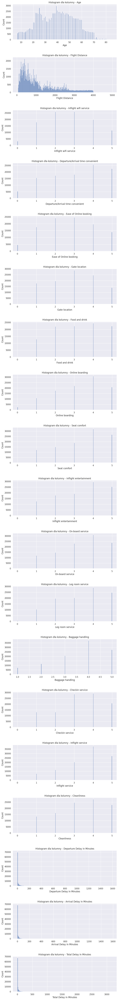

In [ ]:
num_columns = len(columns)
fig, axes = plt.subplots(num_columns, 1, figsize=(10, 5*num_columns))

for i, col in enumerate(columns):
    sns.histplot(data=df, x=col, bins=300, ax=axes[i])
    axes[i].set_title(f"Histogram dla kolumny - {col}")

plt.subplots_adjust(hspace=0.5)  # Dodanie odstępu między histogramami
plt.show()


Outliery pojawiły się w kolumnach: 'Age', 'Flight Distance'. 

### Age


In [ ]:
df[df['Age'] > 80]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction
2023,Male,Loyal Customer,85,Business travel,Business,1904,3,2,2,2,2,3,3,1,2,3,3,3,1,3,14,7.0,21.0,neutral or dissatisfied
19187,Male,Loyal Customer,85,Business travel,Business,3732,3,4,4,4,3,3,3,3,3,3,3,3,3,3,1,0.0,1.0,neutral or dissatisfied
28863,Male,Loyal Customer,85,Business travel,Business,2078,1,1,5,1,5,4,4,3,4,5,5,4,4,4,82,76.0,158.0,satisfied
30723,Female,disloyal Customer,85,Business travel,Business,617,3,3,3,4,3,1,1,3,1,3,3,1,2,1,58,59.0,117.0,neutral or dissatisfied
31868,Female,Loyal Customer,85,Business travel,Eco Plus,147,4,4,4,4,4,4,4,2,1,3,4,4,1,4,3,0.0,3.0,neutral or dissatisfied
35919,Female,Loyal Customer,85,Business travel,Business,3156,3,5,5,5,4,3,3,3,1,4,4,3,3,3,0,0.0,0.0,neutral or dissatisfied
37138,Female,Loyal Customer,85,Business travel,Business,187,2,3,3,3,4,2,4,3,5,4,4,4,1,4,17,11.0,28.0,neutral or dissatisfied
37790,Female,disloyal Customer,85,Business travel,Business,899,2,2,2,4,2,3,3,2,3,4,4,3,3,3,0,0.0,0.0,neutral or dissatisfied
44343,Female,disloyal Customer,85,Business travel,Business,586,2,2,2,3,2,2,5,2,4,3,1,5,2,5,0,0.0,0.0,neutral or dissatisfied
47096,Female,disloyal Customer,85,Business travel,Eco,366,3,2,3,3,3,3,3,3,1,2,2,3,1,3,0,0.0,0.0,neutral or dissatisfied


Text(0.5, 1.0, "Histogram dla kolumny - 'Age'")

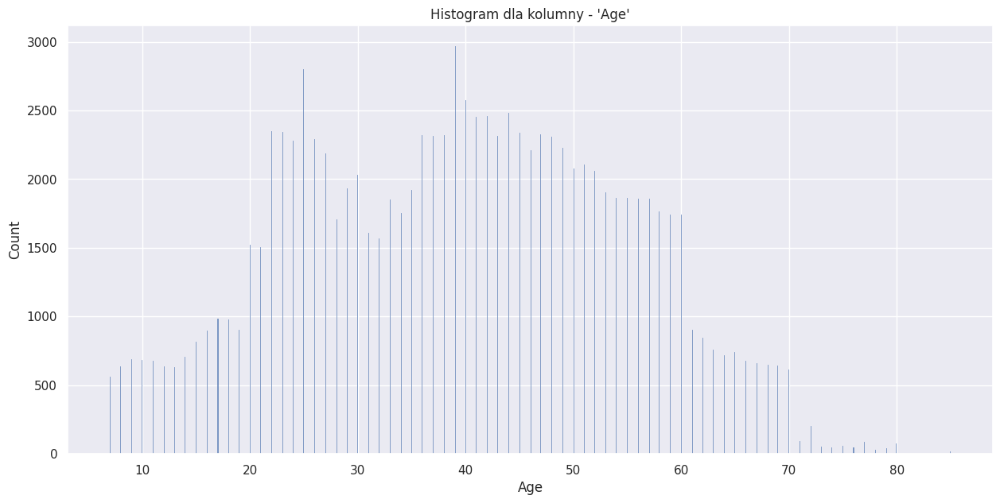

In [ ]:
age = sns.histplot(data=df, x='Age', bins=1000)
age.set_title(f"Histogram dla kolumny - 'Age'")

Widać, że wartości powyżej wieku 80 lat stanowią mniejszość, stąd też decyzja o ich usunięciu.

In [ ]:
df['Age'] = df['Age'].mask(df['Age'] > 80, 80)

In [ ]:
df[df['Age'] > 80]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction


<Axes: xlabel='Age', ylabel='Count'>

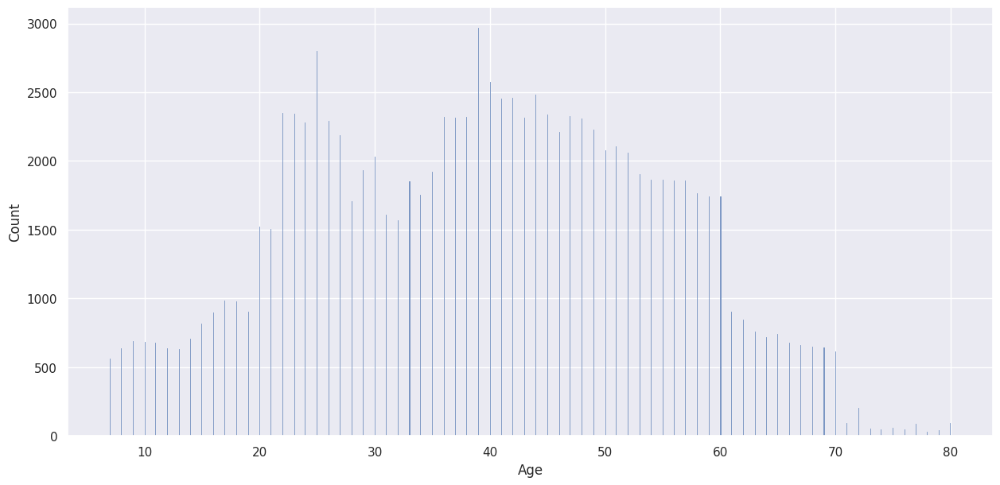

In [ ]:
sns.histplot(data=df, x='Age', bins=1000)

### Flight Distance

In [ ]:
df[df['Flight Distance'] > 4000]

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction
994,Female,Loyal Customer,26,Business travel,Business,4243,2,2,2,2,4,4,4,3,5,4,4,4,5,4,26,0.0,26.0,satisfied
2401,Female,Loyal Customer,25,Personal Travel,Eco,4963,2,5,2,4,2,5,2,5,3,4,4,2,3,2,0,0.0,0.0,neutral or dissatisfied
2847,Female,Loyal Customer,63,Personal Travel,Business,4983,0,5,0,2,0,5,1,3,2,4,3,1,5,1,3,0.0,3.0,satisfied
5903,Female,Loyal Customer,25,Business travel,Business,4243,4,5,3,5,3,4,4,3,2,3,4,4,4,4,4,0.0,4.0,neutral or dissatisfied
11306,Male,disloyal Customer,22,Business travel,Business,4243,5,0,5,5,5,5,5,5,5,3,5,5,4,5,14,16.0,30.0,satisfied
11788,Male,Loyal Customer,52,Business travel,Business,4243,2,2,2,2,4,4,4,5,2,5,4,4,3,4,52,46.0,98.0,satisfied
15545,Female,Loyal Customer,45,Business travel,Business,4963,1,1,1,1,2,1,1,3,3,5,4,1,3,1,0,13.0,13.0,satisfied
18434,Female,Loyal Customer,31,Business travel,Eco,4983,4,3,3,3,4,4,4,3,2,5,2,4,1,4,18,0.0,18.0,satisfied
18977,Female,Loyal Customer,42,Business travel,Eco Plus,4817,2,2,2,2,2,2,2,2,4,1,3,2,3,2,17,14.0,31.0,neutral or dissatisfied
19755,Female,Loyal Customer,50,Business travel,Business,4983,5,4,5,5,5,1,5,3,2,4,3,5,5,5,0,0.0,0.0,satisfied


Text(0.5, 1.0, "Histogram dla kolumny - 'Flight Distance'")

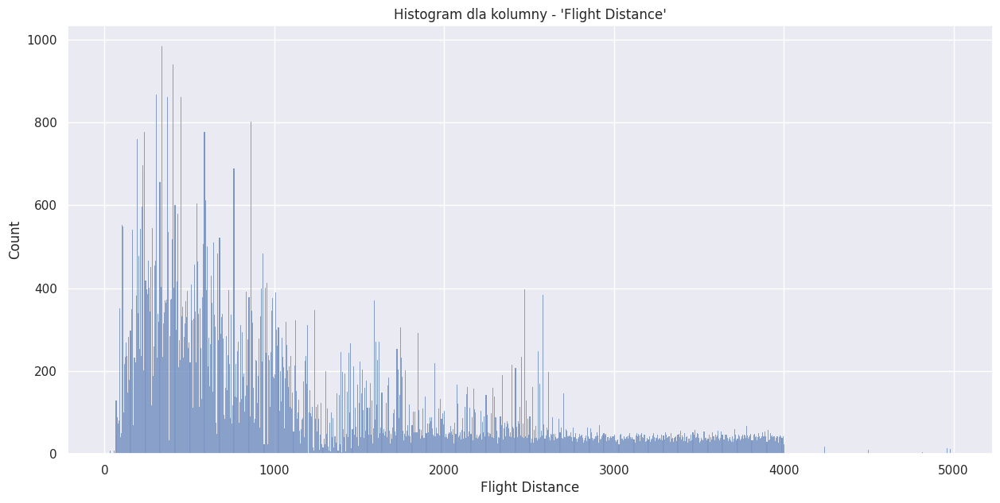

In [ ]:
flight_distance = sns.histplot(data=df, x='Flight Distance', bins=1000)
flight_distance.set_title(f"Histogram dla kolumny - 'Flight Distance'")

Widać, że wartości powyżej 4000 km stanowią mniejszość, stąd też decyzja o ich usunięciu.

In [ ]:
df['Flight Distance'] = df['Flight Distance'].mask(df['Flight Distance'] > 4000, 4000)

<Axes: xlabel='Flight Distance', ylabel='Count'>

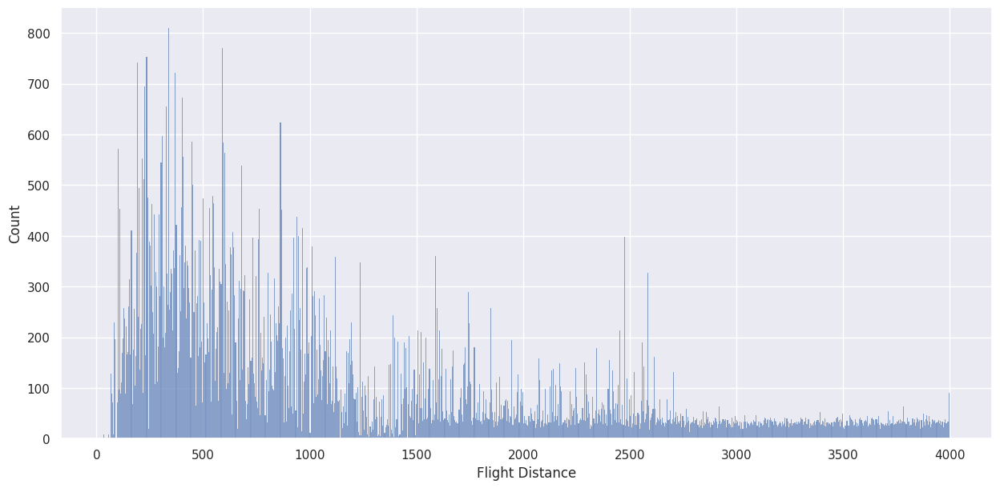

In [ ]:
sns.histplot(data=df, x='Flight Distance', bins=1000)

# 3. Korelacja danych

In [ ]:
import plotly.express as px

In [ ]:
corr=df.corr()
fig = px.imshow(corr, text_auto=True,width=1200,height=1200)
fig.show()

<ipython-input-38-7fa42f08dec3>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr=df.corr()


### Korelacja Spearmana

<ipython-input-39-32a8a08ac0c6>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

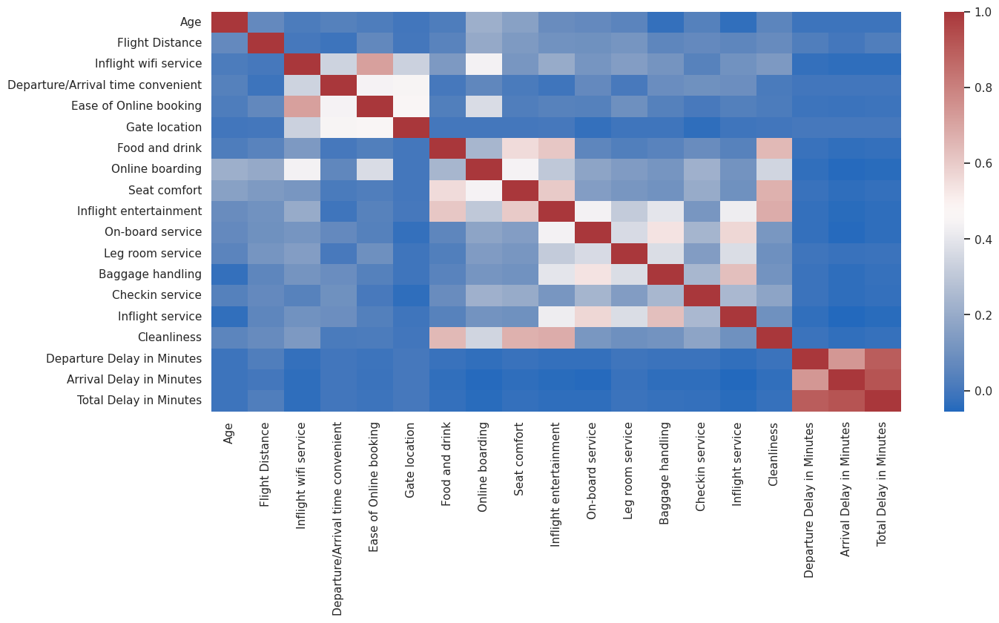

In [ ]:
corr_mat = df.corr("spearman")
sns.heatmap(corr_mat, cmap="vlag")

<Axes: >

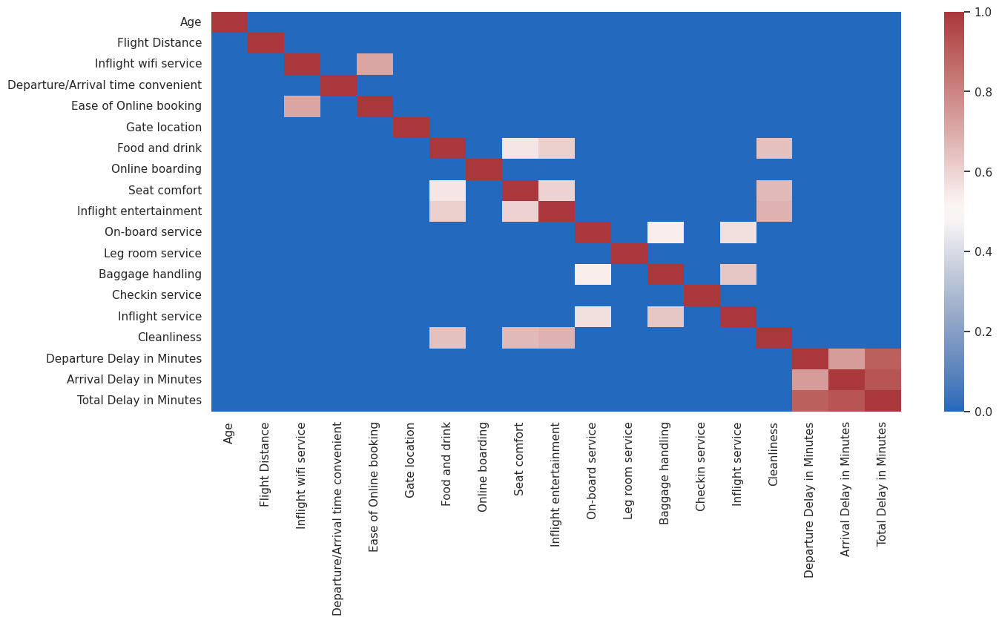

In [ ]:
corr_mat[np.abs(corr_mat) < 0.5] = 0
sns.heatmap(corr_mat, cmap="vlag")

### Korelacja Pearsona

<ipython-input-216-58bc017c4418>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

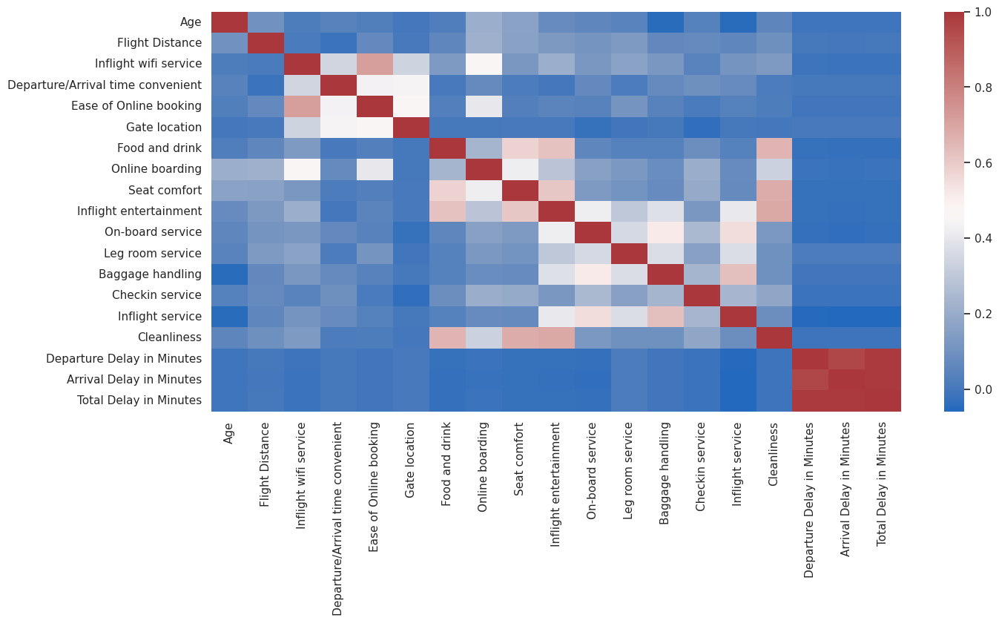

In [ ]:
corr_mat = df.corr("pearson")
sns.heatmap(corr_mat, cmap="vlag")

<Axes: >

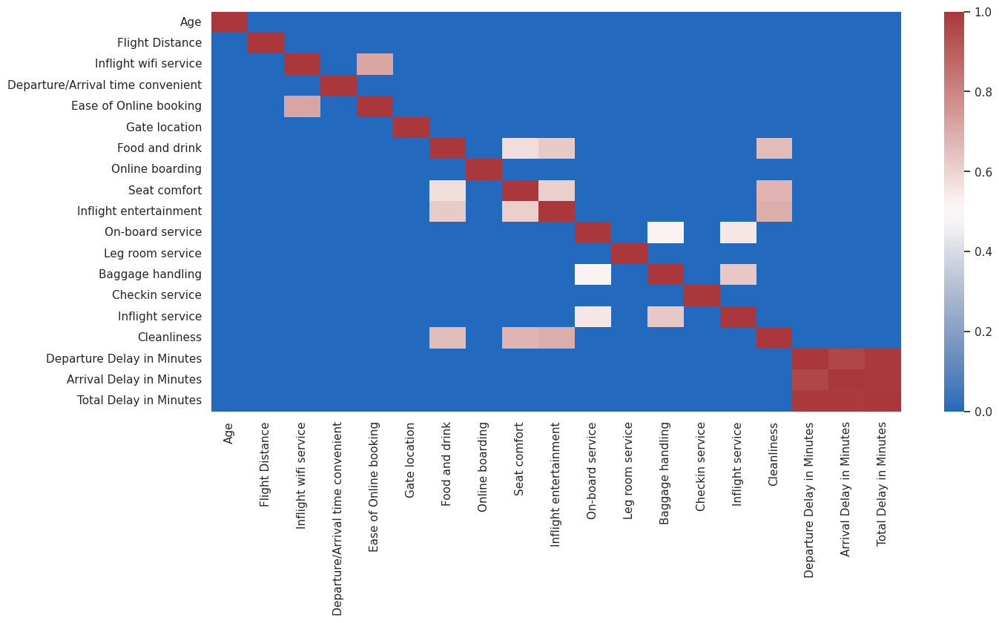

In [ ]:
corr_mat[np.abs(corr_mat) < 0.5] = 0
sns.heatmap(corr_mat, cmap="vlag")

### Korelacja Kendalla

<ipython-input-218-3a658cc1c759>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

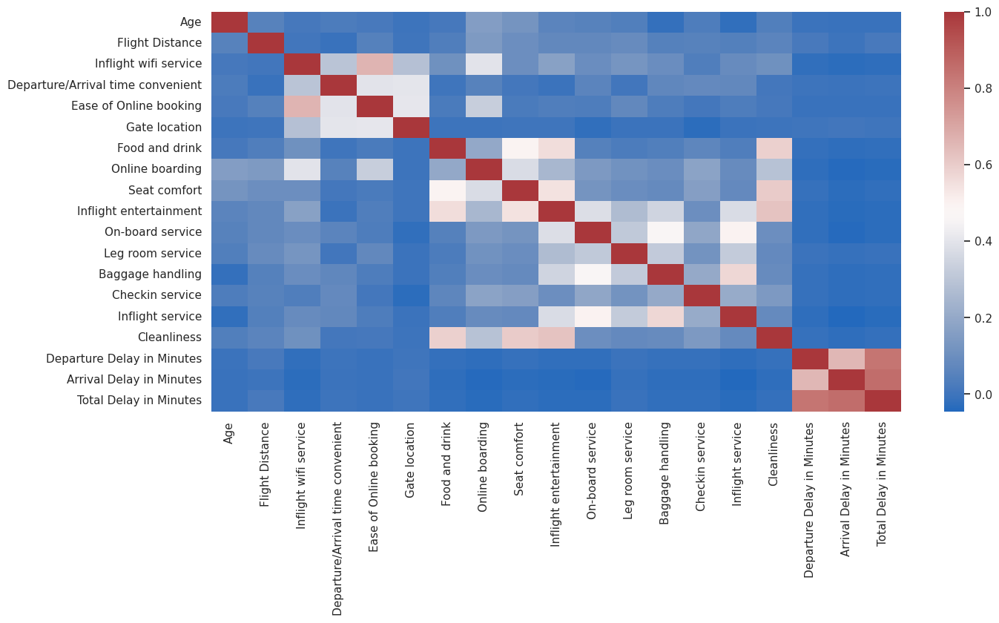

In [ ]:
corr_mat = df.corr("kendall")
sns.heatmap(corr_mat, cmap="vlag")

<Axes: >

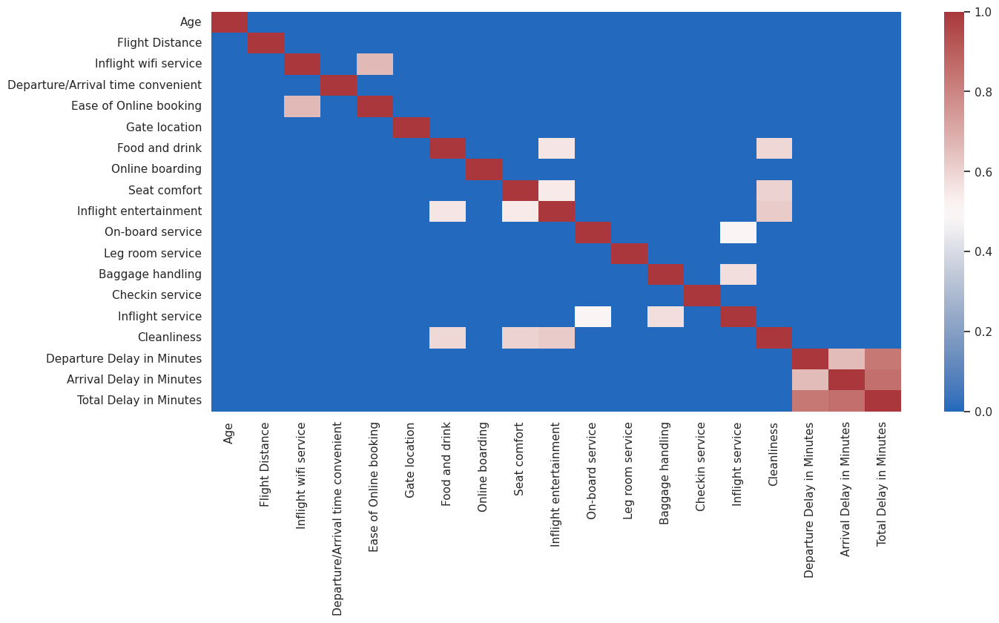

In [ ]:
corr_mat[np.abs(corr_mat) < 0.5] = 0
sns.heatmap(corr_mat, cmap="vlag")

Widoczna zależnosć występuje między kolumnami 'Arrival Delay in Minutes' ,a  'Departure Delay in Minutes'

###  Korelacja kolumny 'Arrival Delay in Minute' z 'Departure Delay in Minutes'

In [ ]:
scipy.stats.spearmanr(df['Arrival Delay in Minutes'], df['Departure Delay in Minutes'])

SignificanceResult(statistic=0.7400800590967154, pvalue=0.0)

Potwierdza to również poniższy wykres

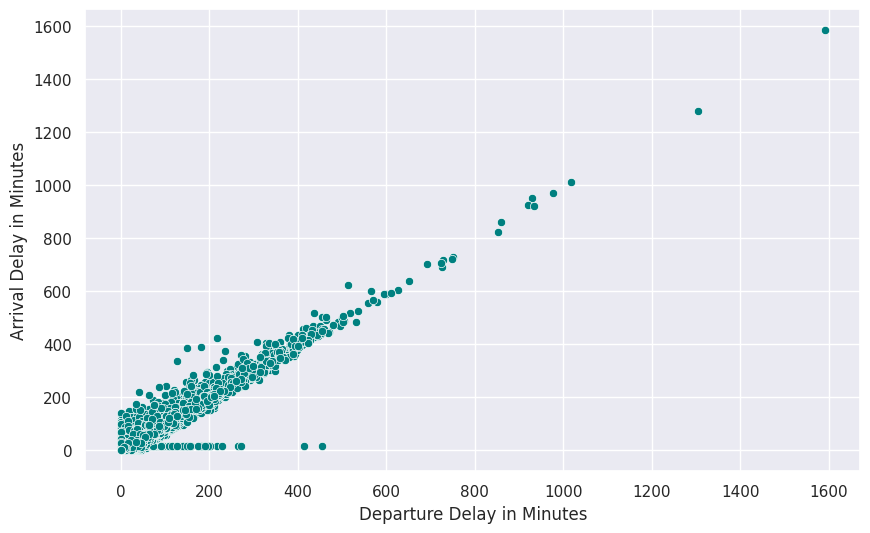

In [ ]:
plt.figure(figsize = (10, 6))
sns.scatterplot(x = 'Departure Delay in Minutes', y = 'Arrival Delay in Minutes', data = df, color = 'teal')
plt.show()

### Korelacja kolumny 'Arrival Delay in Minute' z 'Total Delay in Minutes'

In [ ]:
scipy.stats.spearmanr(df['Arrival Delay in Minutes'], df['Total Delay in Minutes'])

SignificanceResult(statistic=0.9223960263192321, pvalue=0.0)

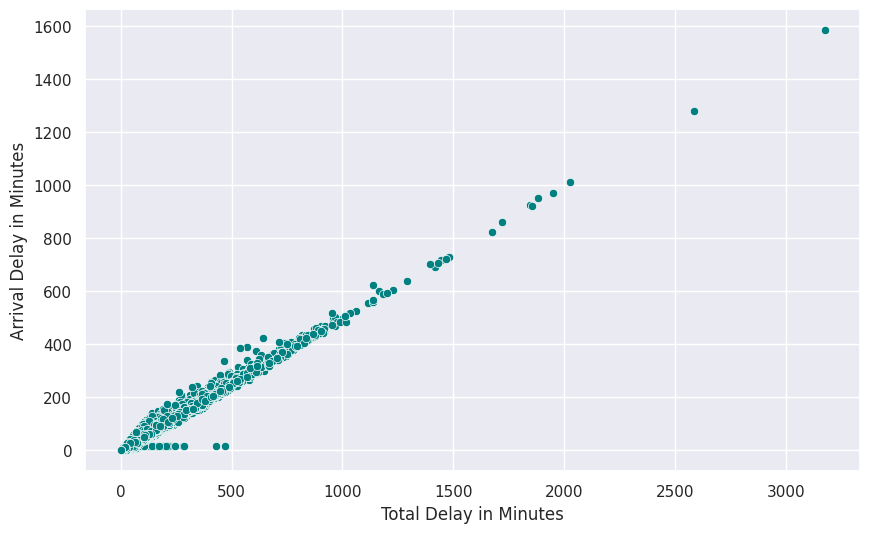

In [ ]:
plt.figure(figsize = (10, 6))
sns.scatterplot(x = 'Total Delay in Minutes', y = 'Arrival Delay in Minutes', data = df, color = 'teal')
plt.show()

Korelacja kolumny 'Arrival Delay in Minute' z 'Departure Delay in Minutes'

In [ ]:
scipy.stats.spearmanr(df['Departure Delay in Minutes'], df['Total Delay in Minutes'])

SignificanceResult(statistic=0.8972188166228572, pvalue=0.0)

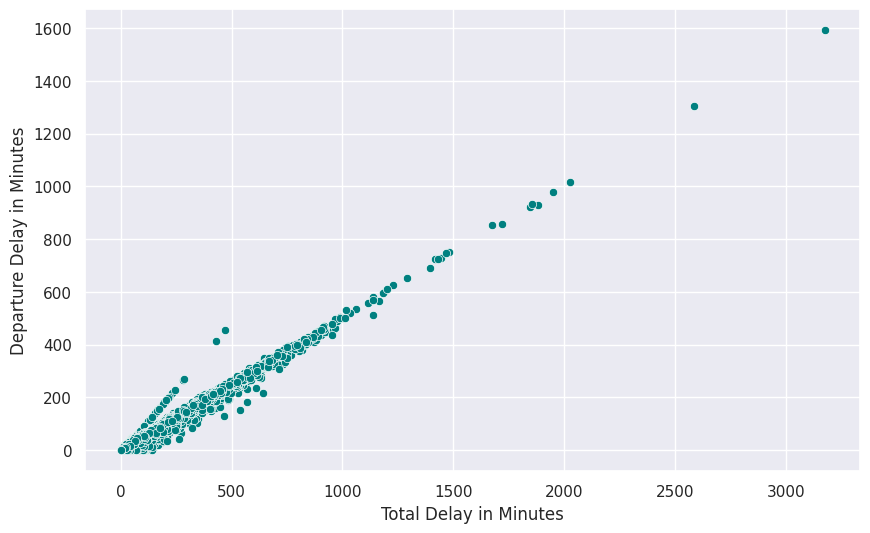

In [ ]:
plt.figure(figsize = (10, 6))
sns.scatterplot(x = 'Total Delay in Minutes', y = 'Departure Delay in Minutes', data = df, color = 'teal')
plt.show()

### Korelacja poszczególnych kolumn z kolumną satysfakcji klienta. 

W tej cześci projektu zakodowano kolumnę 'satisfaction' zgodnie z metodą OrdinalEncoder - 'neutral or dissatisfied' : 0, 'satisfied' : 1


In [ ]:
df_test = test_data.copy()

In [ ]:
df['satisfaction'] = df['satisfaction'].map({'neutral or dissatisfied' : 0, 'satisfied' : 1})
df_test['satisfaction'] = df_test['satisfaction'].map({'neutral or dissatisfied' : 0, 'satisfied' : 1})

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class_Business,Class_Eco,Class_Eco Plus
0,13,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,43.0,0,0,1,1,0,0,1,0,0,1
1,25,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,7.0,0,0,1,0,1,1,0,1,0,0
2,26,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,0.0,1,1,0,1,0,1,0,1,0,0
3,25,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,20.0,0,1,0,1,0,1,0,1,0,0
4,61,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,0.0,1,0,1,1,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,23,192,2,1,2,3,2,2,2,2,3,1,4,2,3,2,3,0.0,3.0,0,1,0,0,1,1,0,0,1,0
103900,49,2347,4,4,4,4,2,4,5,5,5,5,5,5,5,4,0,0.0,0.0,1,0,1,1,0,1,0,1,0,0
103901,30,1995,1,1,1,3,4,1,5,4,3,2,4,5,5,4,7,14.0,21.0,0,0,1,0,1,1,0,1,0,0
103902,22,1000,1,1,1,5,1,1,1,1,4,5,1,5,4,1,0,0.0,0.0,0,1,0,0,1,1,0,0,1,0


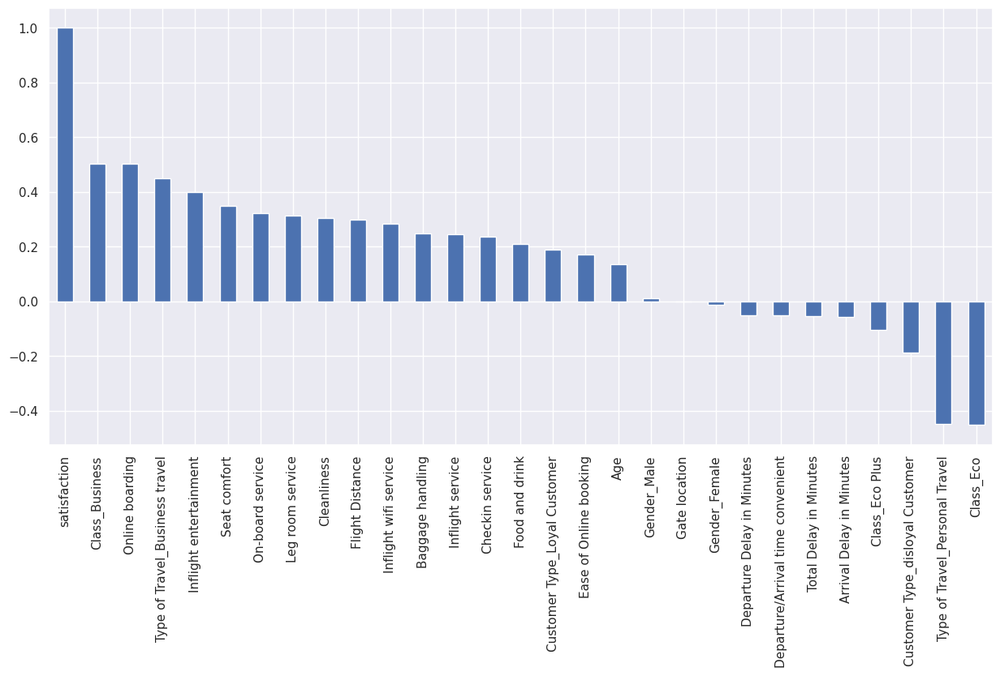

In [ ]:
df_dummies = pd.get_dummies(df)
df_dummies.corr()['satisfaction'].sort_values(ascending = False).plot(kind='bar')
df_dummies

# 4. Kodowanie zmiennych kategorycznych

Kolejnym krokiem w przygotowywaniu naszych danych jest zamiana zmiennych kategorycznych na liczbowe w tym celu zastosowano dwa rodzaje kodowania - OneHotEncoder (nie zachowuje porządku danych) i OrdinalEncoder (zachowuje porządek danych)

In [ ]:
# Zmienne kategoryczne
from tabulate import tabulate

cat_columns = df.select_dtypes(object).columns.to_list()
table = [['Column', 'Values']]
for col in cat_columns:
    unique_values = df[col].unique()
    table.append([col, unique_values])
    #print(f'Kolumna ({col}) - wartości: {unique_values}')
print("Treningowy")
print(tabulate(table, headers='firstrow'))

print("\nTestowy")
cat_columns_test = df_test.select_dtypes(object).columns.to_list()
table_test = [['Column', 'Values']]
for col in cat_columns_test:
    unique_values = df_test[col].unique()
    table_test.append([col, unique_values])
    #print(f'Kolumna ({col}) - wartości: {unique_values}')
print(tabulate(table_test, headers='firstrow'))

Treningowy
Column          Values
--------------  --------------------------------------
Gender          ['Male' 'Female']
Customer Type   ['Loyal Customer' 'disloyal Customer']
Type of Travel  ['Personal Travel' 'Business travel']
Class           ['Eco Plus' 'Business' 'Eco']

Testowy
Column          Values
--------------  --------------------------------------
Gender          ['Female' 'Male']
Customer Type   ['Loyal Customer' 'disloyal Customer']
Type of Travel  ['Business travel' 'Personal Travel']
Class           ['Eco' 'Business' 'Eco Plus']


In [ ]:
df1 = df.copy()

## OneHotEncoding

Kolumny poddane temu rodzajowi kodowania to: "Gender", "Customer Type", "Type of Travel"

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
# Wybrane kolumny
columns_to_encode = ["Gender", "Customer Type", "Type of Travel"]

# Inicjalizacja enkodera one-hot
onehot_encoder = OneHotEncoder(sparse_output=False)

# Kodowanie wartości dla każdej kolumny
new_columns = onehot_encoder.fit_transform(df1[columns_to_encode])
new_columns_test = onehot_encoder.fit_transform(df_test[columns_to_encode])

# Pobranie nazw nowych kolumn
new_columns_names = onehot_encoder.get_feature_names_out(columns_to_encode)

# Tworzenie nowego DataFrame z zakodowanymi kolumnami
df_temp = pd.DataFrame(data=new_columns, columns=new_columns_names)
df_test_temp = pd.DataFrame(data=new_columns_test, columns=new_columns_names)
df_temp.head()

,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel
0,0.0,1.0,1.0,0.0,0.0,1.0
1,0.0,1.0,0.0,1.0,1.0,0.0
2,1.0,0.0,1.0,0.0,1.0,0.0
3,1.0,0.0,1.0,0.0,1.0,0.0
4,0.0,1.0,1.0,0.0,1.0,0.0


In [ ]:
df1 = df1.join(df_temp)
df_test = df_test.join(df_test_temp)

# usunięcie kolumn kategorycznych
df1 = df1.drop(columns=["Gender", "Customer Type", "Type of Travel"])
df_test = df_test.drop(columns=["Gender", "Customer Type", "Type of Travel"])

In [ ]:
df1.head()

,Age,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel
0,13,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,43.0,0,0.0,1.0,1.0,0.0,0.0,1.0
1,25,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,7.0,0,0.0,1.0,0.0,1.0,1.0,0.0
2,26,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,0.0,1,1.0,0.0,1.0,0.0,1.0,0.0
3,25,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,20.0,0,1.0,0.0,1.0,0.0,1.0,0.0
4,61,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,0.0,1,0.0,1.0,1.0,0.0,1.0,0.0


In [ ]:
df_test.head()

,Age,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel
0,52,Eco,160,5,4,3,4,3,4,3,5,5,5,5,2,5,5,50,44.0,94.0,1,1.0,0.0,1.0,0.0,1.0,0.0
1,36,Business,2863,1,1,3,1,5,4,5,4,4,4,4,3,4,5,0,0.0,0.0,1,1.0,0.0,1.0,0.0,1.0,0.0
2,20,Eco,192,2,0,2,4,2,2,2,2,4,1,3,2,2,2,0,0.0,0.0,0,0.0,1.0,0.0,1.0,1.0,0.0
3,44,Business,3377,0,0,0,2,3,4,4,1,1,1,1,3,1,4,0,6.0,6.0,1,0.0,1.0,1.0,0.0,1.0,0.0
4,49,Eco,1182,2,3,4,3,4,1,2,2,2,2,2,4,2,4,0,20.0,20.0,1,1.0,0.0,1.0,0.0,1.0,0.0


## OrdinalEncoder

Kolumny poddane temu rodzajowi kodowania to: "Class", która ma swój naturalny porządek (Eco -> Eco Plus -> Business), więc możemy ją zakodować wartościami 0,1,2

In [ ]:
from sklearn.preprocessing import OrdinalEncoder

In [ ]:
ordinal_encoder = OrdinalEncoder(categories=[['Eco', 'Eco Plus', 'Business']]) 
new_columns = ordinal_encoder.fit_transform(df1[["Class"]]) 
new_columns_test = ordinal_encoder.fit_transform(df_test[["Class"]]) 
new_columns_names = ordinal_encoder.get_feature_names_out() 

df_temp = pd.DataFrame(data=new_columns, columns=new_columns_names) 
df_test_temp = pd.DataFrame(data=new_columns_test, columns=new_columns_names)
df_temp.head()

,Class
0,1.0
1,2.0
2,2.0
3,2.0
4,2.0


In [ ]:
categories_df1 = ordinal_encoder.categories_
categories_df_test = ordinal_encoder.categories_

print(categories_df1)
print(categories_df_test)

[array(['Eco', 'Eco Plus', 'Business'], dtype=object)]
[array(['Eco', 'Eco Plus', 'Business'], dtype=object)]


In [ ]:
df1 = df1.drop(columns=['Class'])
df1 = df1.join(df_temp)

df_test = df_test.drop(columns=['Class'])
df_test = df_test.join(df_test_temp)

Kolumna 'satisfaction' została zakodowana w poprzednim paragrafie, gdyż konieczne było to do przedstawienia "siły" korelacji satysfakcji klientów linii lotniczych z innymi atrybutami.

In [ ]:
# Przesunięcie klasy decyzyjnej na koniec tabeli
df_temp = df1['satisfaction']
df1 = df1.drop('satisfaction', axis=1)
columns.append('satisfaction')
df1['satisfaction'] = df_temp

df_temp_test = df_test['satisfaction']
df_test = df_test.drop('satisfaction', axis=1)
columns.append('satisfaction')
df_test['satisfaction'] = df_temp_test

In [ ]:
df1.head()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class,satisfaction
0,13,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,43.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0
1,25,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,7.0,0.0,1.0,0.0,1.0,1.0,0.0,2.0,0
2,26,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,2.0,1
3,25,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,20.0,1.0,0.0,1.0,0.0,1.0,0.0,2.0,0
4,61,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,2.0,1


In [ ]:
df_test.head()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class,satisfaction
0,52,160,5,4,3,4,3,4,3,5,5,5,5,2,5,5,50,44.0,94.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1
1,36,2863,1,1,3,1,5,4,5,4,4,4,4,3,4,5,0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,2.0,1
2,20,192,2,0,2,4,2,2,2,2,4,1,3,2,2,2,0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0
3,44,3377,0,0,0,2,3,4,4,1,1,1,1,3,1,4,0,6.0,6.0,0.0,1.0,1.0,0.0,1.0,0.0,2.0,1
4,49,1182,2,3,4,3,4,1,2,2,2,2,2,4,2,4,0,20.0,20.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1


# 5.  Analiza i Eksploracyja Danych (ang. EDA -> Exploratory Data Analysis)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  object 
 1   Customer Type                      103904 non-null  object 
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  object 
 4   Class                              103904 non-null  object 
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Gate location                      103904 non-null  int64  
 10  Food and drink                     103904 non-null  int64  
 11  Online boarding                    1039

## Zmienne numeryczne

In [ ]:
df_describe = df.describe()
df_describe

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,Total Delay in Minutes,satisfaction
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000
mean,39.378888,1189.084636,2.729683,3.060296,2.756901,2.976883,3.202129,3.250375,3.439396,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678,29.994297,0.433333
std,15.112630,995.973743,1.327829,1.525075,1.398929,1.277621,1.329533,1.349509,1.319088,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.640909,76.121761,0.495538
min,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000
50%,40.000000,843.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000,2.000000,0.000000
75%,51.000000,1743.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000,24.000000,1.000000
max,80.000000,4000.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000,3176.000000,1.000000


In [ ]:
df_describe.to_csv('describe_output.csv', index=False)

In [ ]:
num_columns = df.select_dtypes(np.number).columns.to_list()

print("Liczba unikalnych wartości dla każdej zmiennej numerycznej\n")
print(df[num_columns].nunique())

Liczba unikalnych wartości dla każdej zmiennej numerycznej

Age                                    74
Flight Distance                      3797
Inflight wifi service                   6
Departure/Arrival time convenient       6
Ease of Online booking                  6
Gate location                           6
Food and drink                          6
Online boarding                         6
Seat comfort                            6
Inflight entertainment                  6
On-board service                        6
Leg room service                        6
Baggage handling                        5
Checkin service                         6
Inflight service                        6
Cleanliness                             6
Departure Delay in Minutes            446
Arrival Delay in Minutes              456
Total Delay in Minutes                874
satisfaction                            2
dtype: int64


## Zmienne kategoryczne

In [ ]:
df.describe(include = "O")

,Gender,Customer Type,Type of Travel,Class
count,103904,103904,103904,103904
unique,2,2,2,3
top,Female,Loyal Customer,Business travel,Business
freq,52727,84923,71655,49665


In [ ]:
cat_columns = train_data.select_dtypes(object).columns.to_list()
print(cat_columns)
print()
print(train_data[cat_columns].nunique())

['Gender', 'Customer Type', 'Type of Travel', 'Class', 'satisfaction']

Gender            2
Customer Type     2
Type of Travel    2
Class             3
satisfaction      2
dtype: int64


In [ ]:
for col in cat_columns:
  print(f'Kolumna ({col}) - wartości: {train_data[col].unique()}')

Kolumna (Gender) - wartości: ['Male' 'Female']
Kolumna (Customer Type) - wartości: ['Loyal Customer' 'disloyal Customer']
Kolumna (Type of Travel) - wartości: ['Personal Travel' 'Business travel']
Kolumna (Class) - wartości: ['Eco Plus' 'Business' 'Eco']
Kolumna (satisfaction) - wartości: ['neutral or dissatisfied' 'satisfied']


## Wygenerowanie pliku z analizą danych

In [ ]:
profile= pandas_profiling.ProfileReport(train_data)
profile.to_file('Airline-Passenger-Satisfaction-Data-Report.html')

profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Analiza zbioru danych

In [ ]:
def count(df, col, hue = None, annot = True, ax = None):
    """
    Funkcja zliczająca ilość wartości danego atrubutu w kolumnie.

    Argumenty:
    'df': ramka danych, na której ma być wykonany wykres.
    'col': nazwa kolumny, dla której ma zostać utworzony wykres.
    'hue' (opcjonalnie): trzecia zmienna, która może zostać uwzględniona na wykresie.
    'annot' (opcjonalnie): flaga określająca, czy dodać adnotacje z liczbą przypadków i wynikiem procentowym na wykresie.
    'ax' (opcjonalnie): obiekt osi, na którym ma zostać narysowany wykres.
    """
    g = sns.countplot(data = df, x = col, hue = hue, palette = "pastel", ax = ax)
    if annot:
        for p in g.patches:
            percent = p.get_height() * 100 / len(df)
            g.annotate(f"{p.get_height()}\n({percent:.2f}%)",(p.get_x() + 0.2, p.get_height()),
                      ha = "center", va = "bottom", color = "black", fontweight = "bold", fontsize = 10,
                      fontname = "monospace")

    g.set_title(f"{col} - wykres wystąpień", fontsize = 17, fontname = "monospace", fontweight = "bold", pad = 20)
    g.set_xlabel(f"{col}", fontsize = 15, fontname = "monospace", fontweight = "semibold")
    g.set_ylabel("Liczba", fontsize = 15, fontname = "monospace", fontweight = "semibold")
    
    plt.xticks(fontsize = 12, fontweight = "semibold")
    plt.yticks(fontsize = 12, fontweight = "semibold")

In [ ]:
def kde(df, col, ax = None, color = "blue", hue = None):
    """
    Funkcja tworzaca wykres gęstości jądrowej (Kernel Density Estimation - KDE).

    Argumenty:
    'df': ramka danych, na której ma być wykonany wykres.
    'col': nazwa kolumny, dla której ma zostać utworzony wykres.
    'ax' (opcjonalnie): obiekt osi, na którym ma zostać narysowany wykres.
    'color' (opcjonalne): kolor wykresu.
    'hue' (opcjonalnie): trzecia zmienna, która może zostać uwzględniona na wykresie (inny kolor).
    """
    
    g = sns.kdeplot(data = df, x = col, fill = True, color = color, ax = ax, hue = hue)
        
    g.set_title(f"Wykres KDE dla kolumny - {col}", fontsize = 17, weight = "bold", fontname = "monospace", pad = 20)
    g.set_xlabel(col, fontsize = 15, weight = "semibold", fontname = "monospace")
    g.set_ylabel("Gęstość", fontsize = 15, weight = "semibold", fontname = "monospace")
    
    plt.xticks(fontsize = 12, fontweight = "semibold")
    plt.yticks(fontsize = 12, fontweight = "semibold")
    plt.show()

### Gender

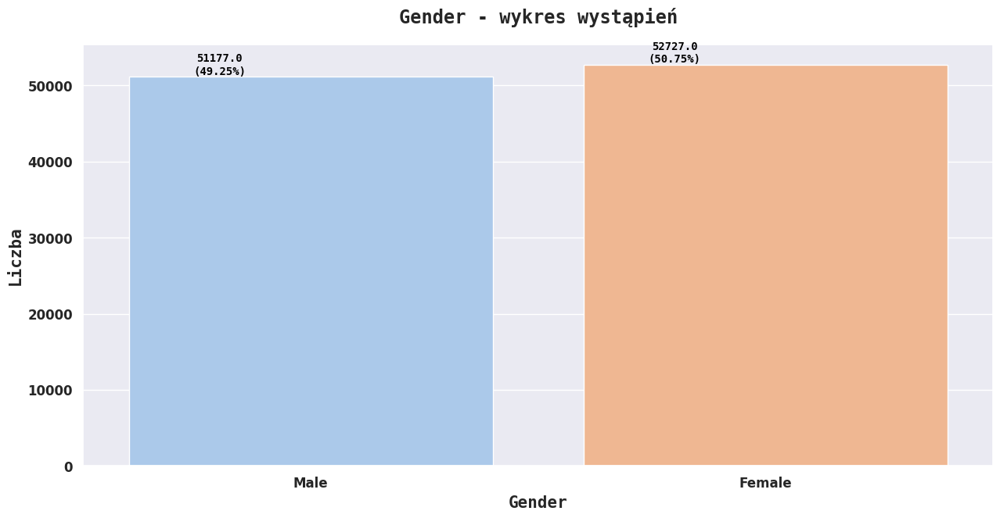

In [ ]:
count(df, "Gender")

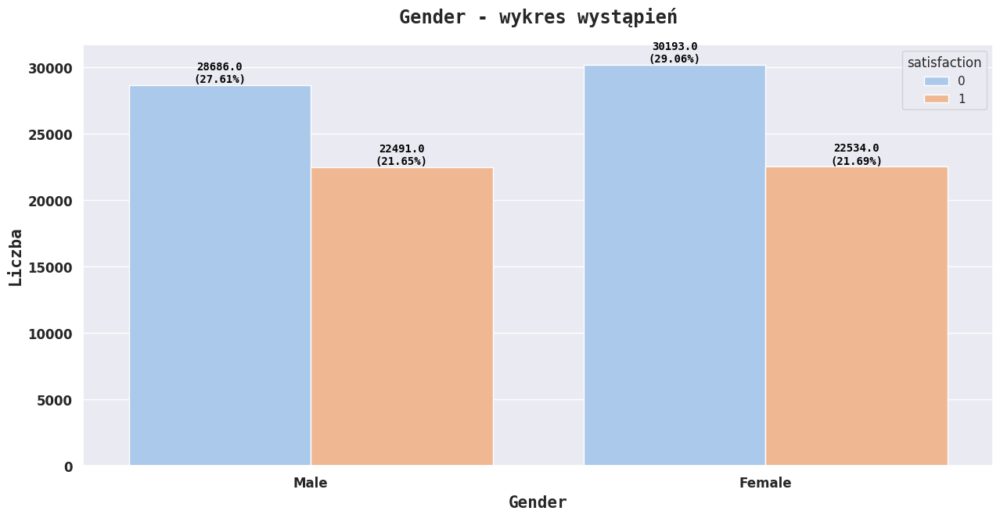

In [ ]:
count(df, "Gender", hue = "satisfaction")

### Age

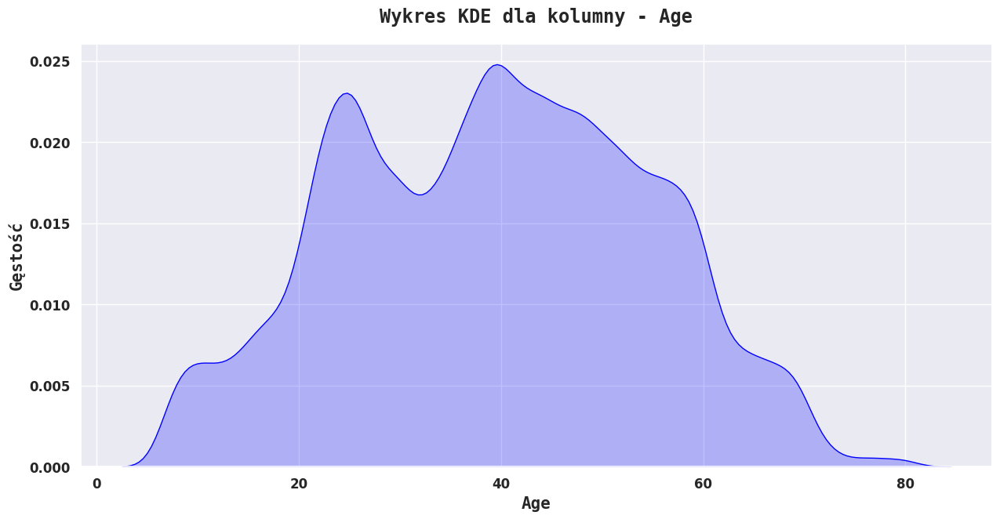

In [ ]:
kde(df, "Age")

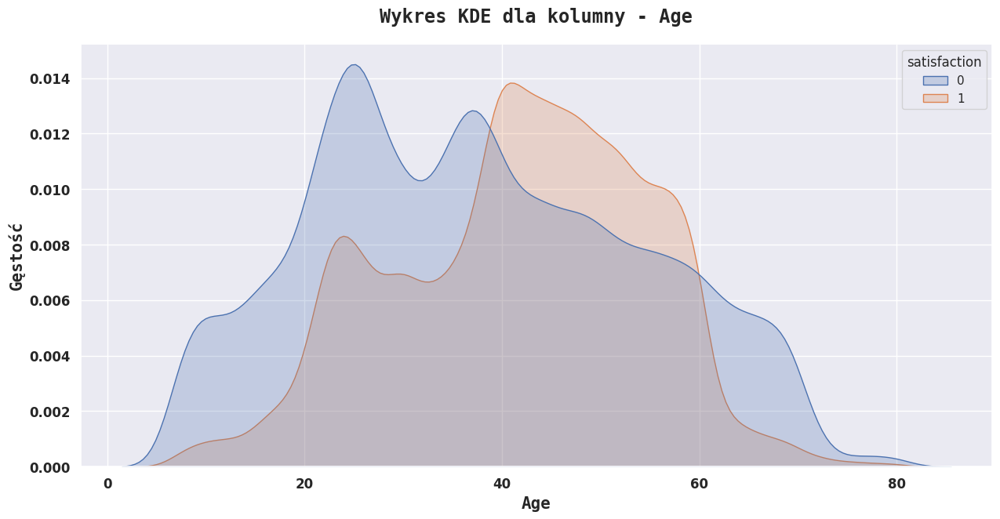

In [ ]:
kde(df, "Age", hue = "satisfaction")

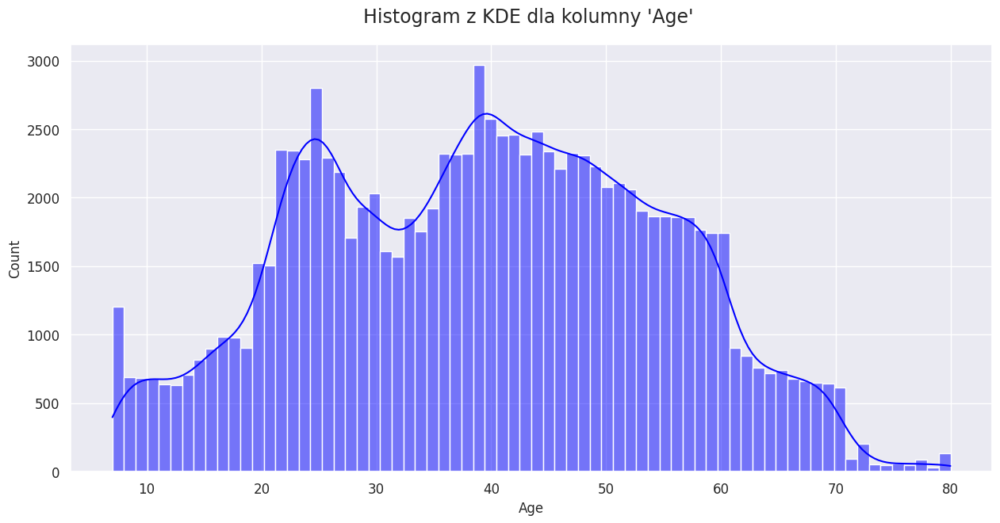

In [ ]:
hist = sns.histplot(data=df, x="Age", kde=True, color='blue')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title(f"Histogram z KDE dla kolumny 'Age' ", fontsize=17, pad=20)
plt.show()

### Transformacja zmiennych

In [ ]:
from sklearn.preprocessing import QuantileTransformer

In [ ]:
data_age = df.copy()

In [ ]:
normal_transformer = QuantileTransformer(output_distribution='normal')
data_age['Age'] = normal_transformer.fit_transform(data_age[['Age']])

<Axes: xlabel='Age', ylabel='Count'>

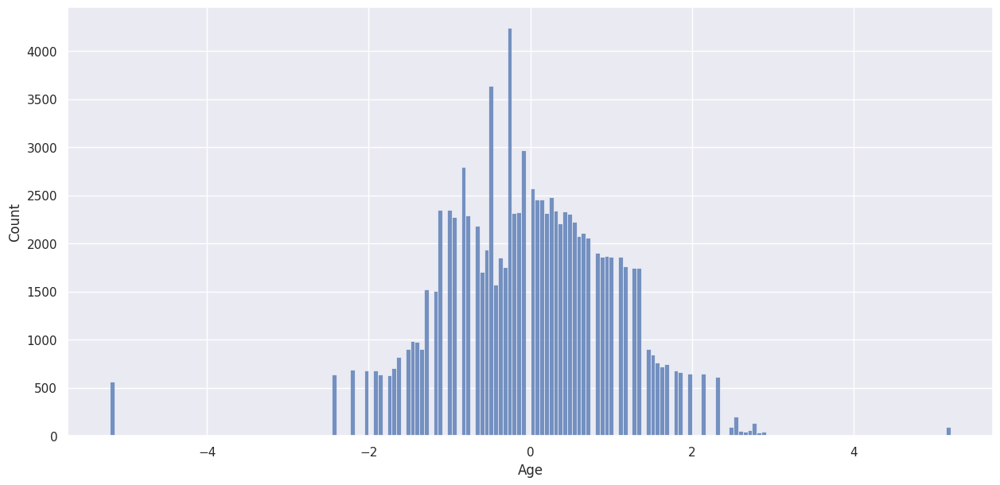

In [ ]:
sns.histplot(data=data_age, x='Age')

Widać, że zmienna 'Age' ma ograniczoną liczbę wartości, więc transformacja do rozkładu normalnego nie jest do końca udana.


### Customer Type

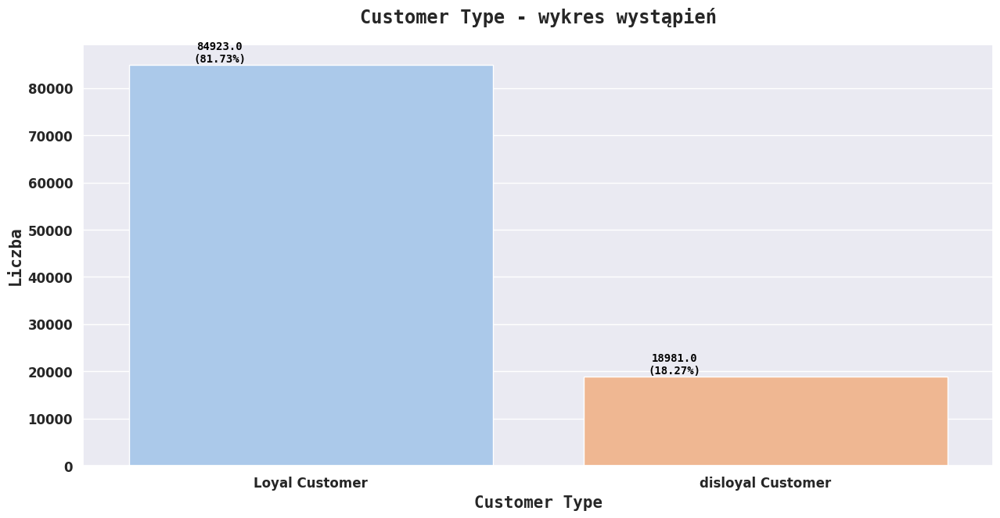

In [ ]:
count(df, "Customer Type")

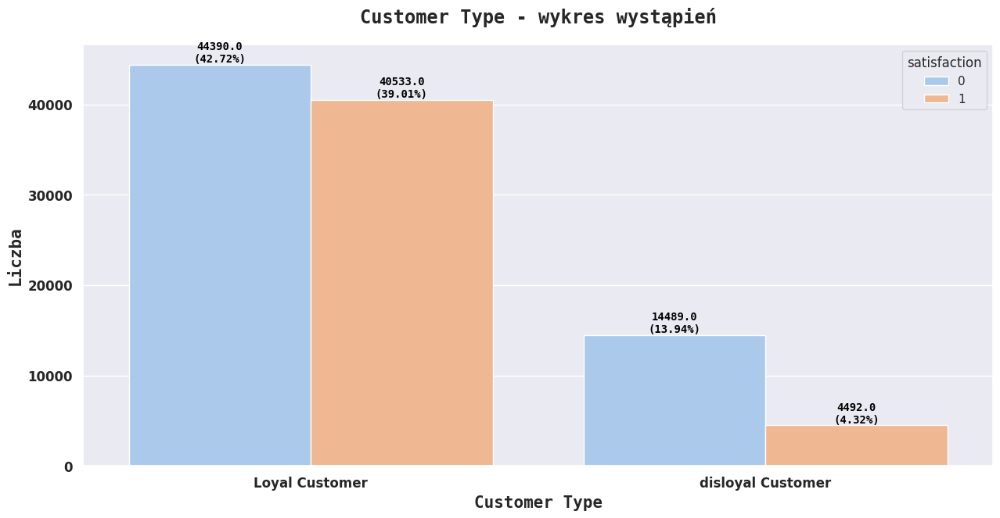

In [ ]:
count(df, "Customer Type", hue = "satisfaction")

### Type of Travel

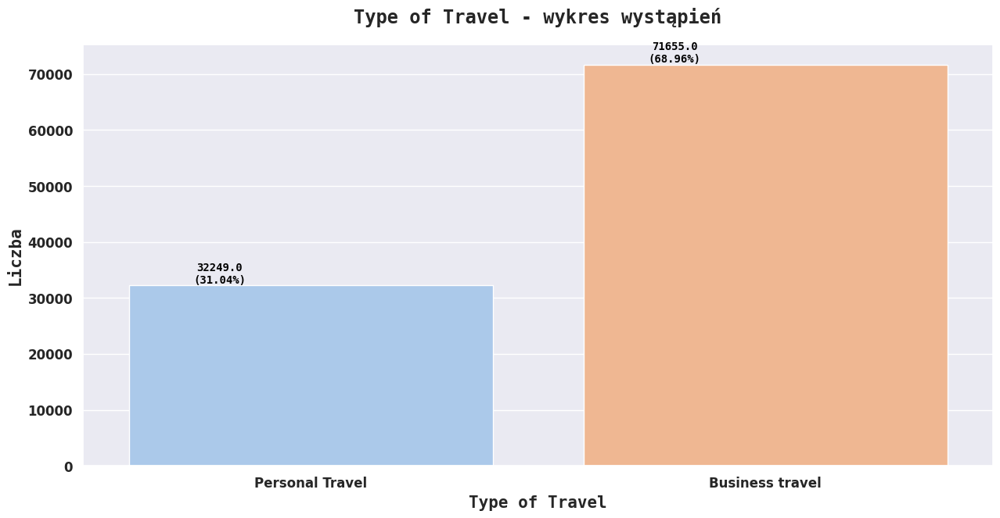

In [ ]:
count(df, "Type of Travel")

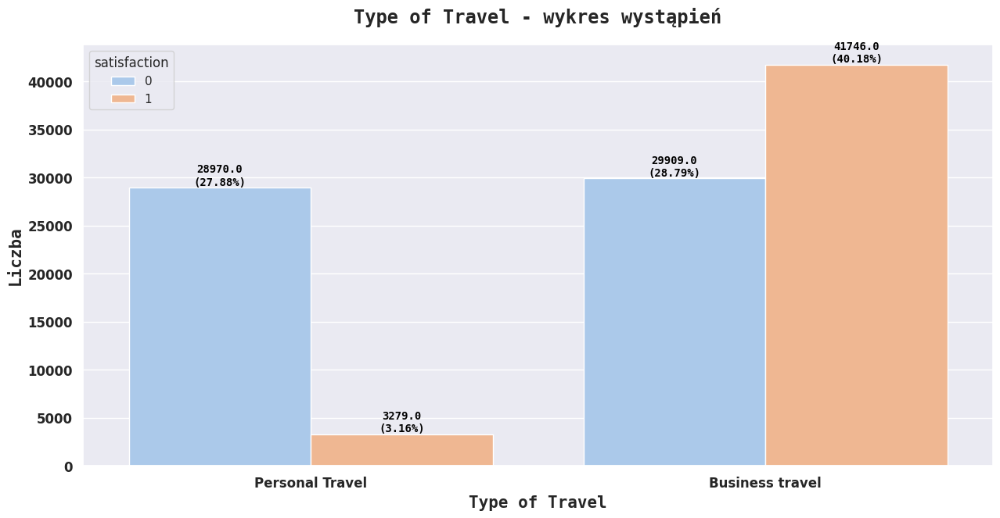

In [ ]:
count(df, "Type of Travel", hue = "satisfaction")

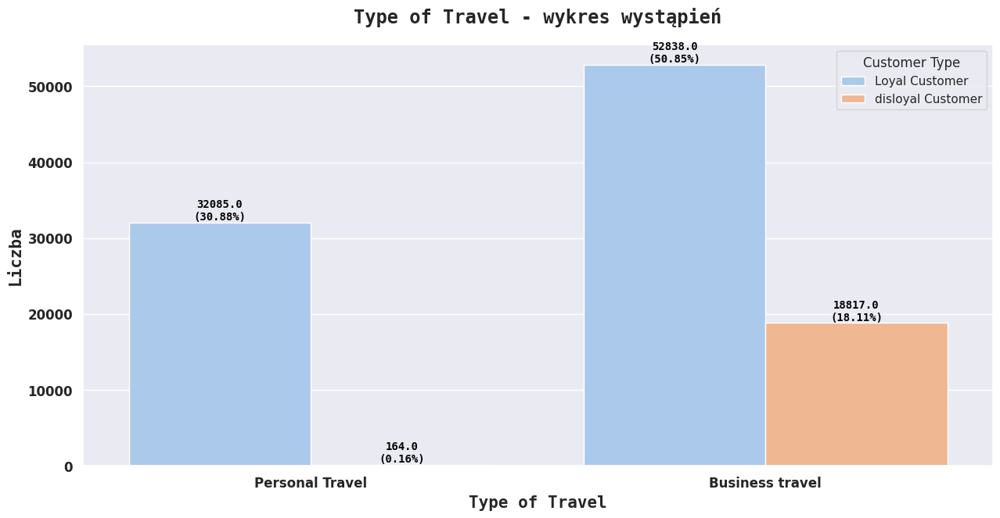

In [ ]:
count(df, "Type of Travel", hue = "Customer Type")

### Class

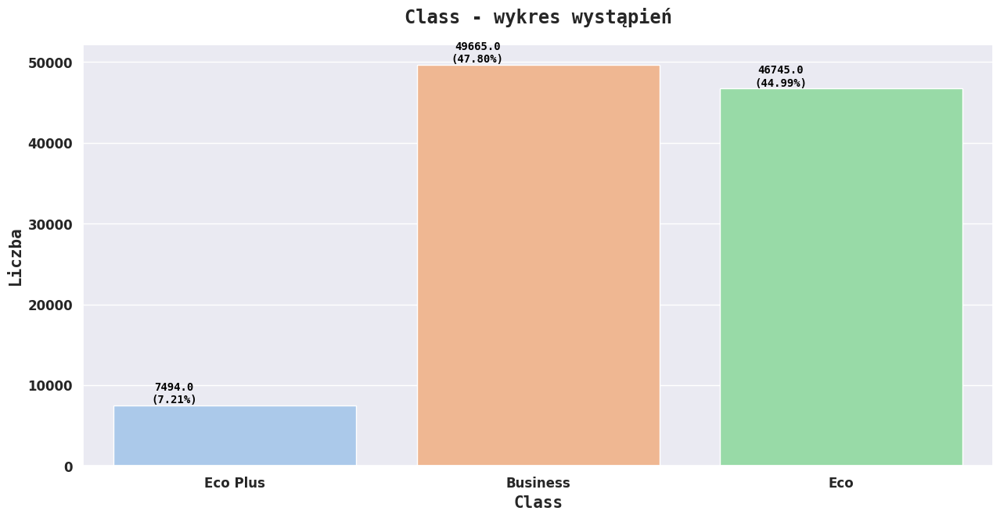

In [ ]:
count(df, "Class")

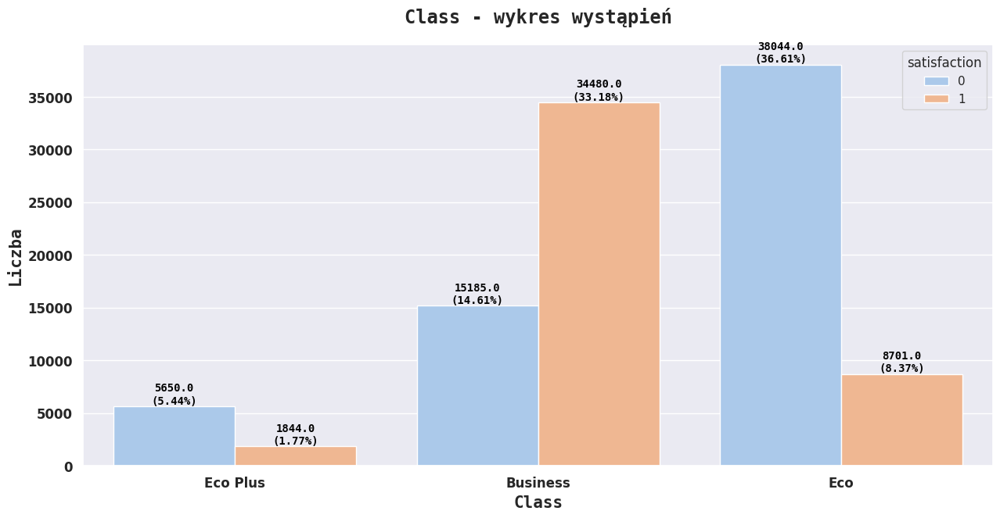

In [ ]:
count(df, "Class", hue = "satisfaction")

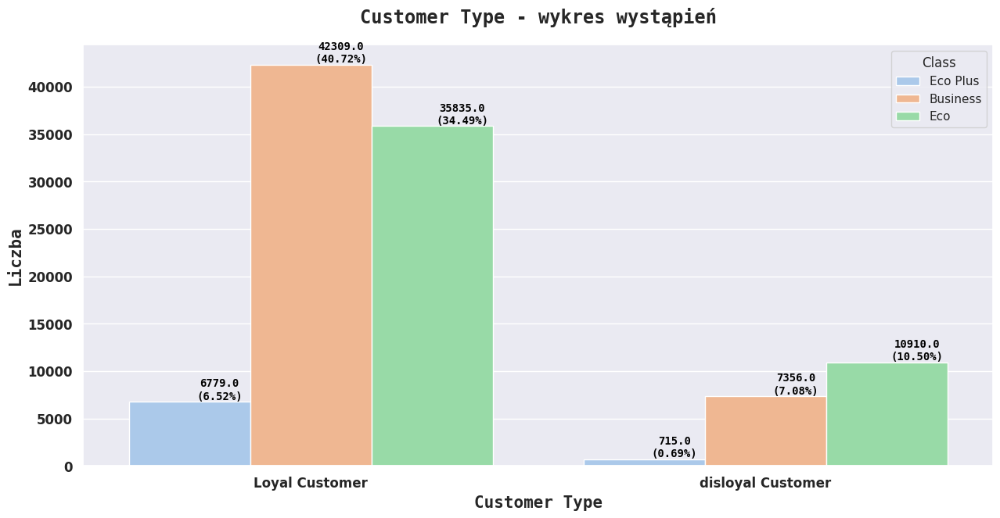

In [ ]:
count(df,"Customer Type", hue = "Class")

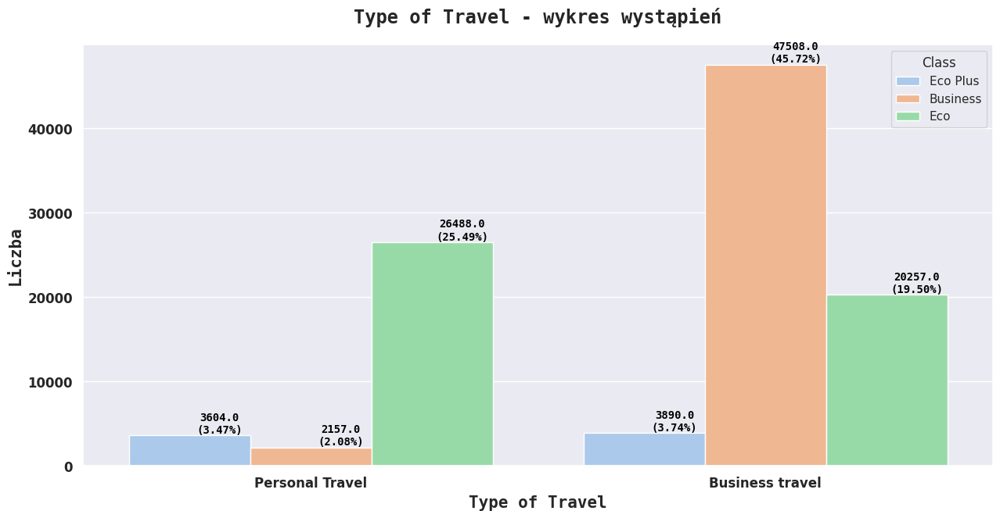

In [ ]:
count(df,"Type of Travel", hue = "Class")

### Flight Distance

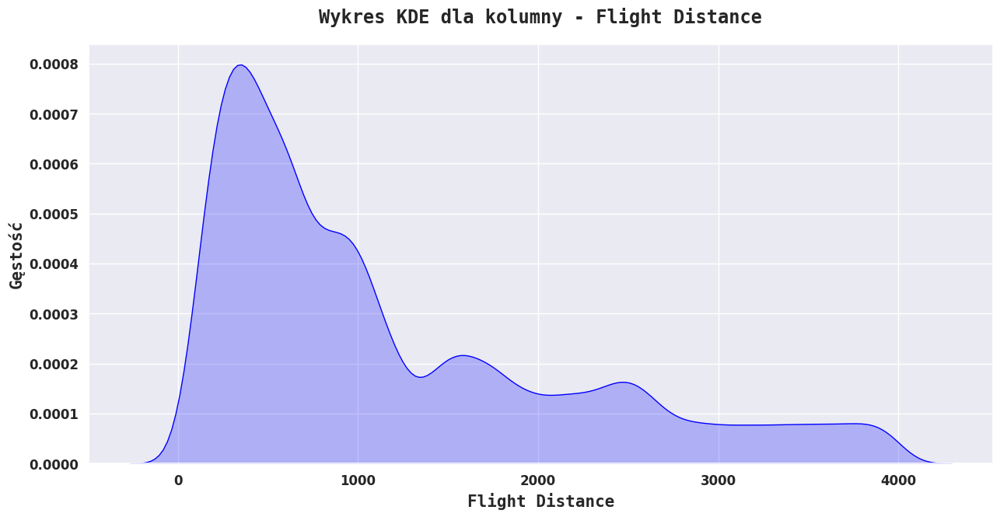

In [ ]:
kde(df, "Flight Distance")

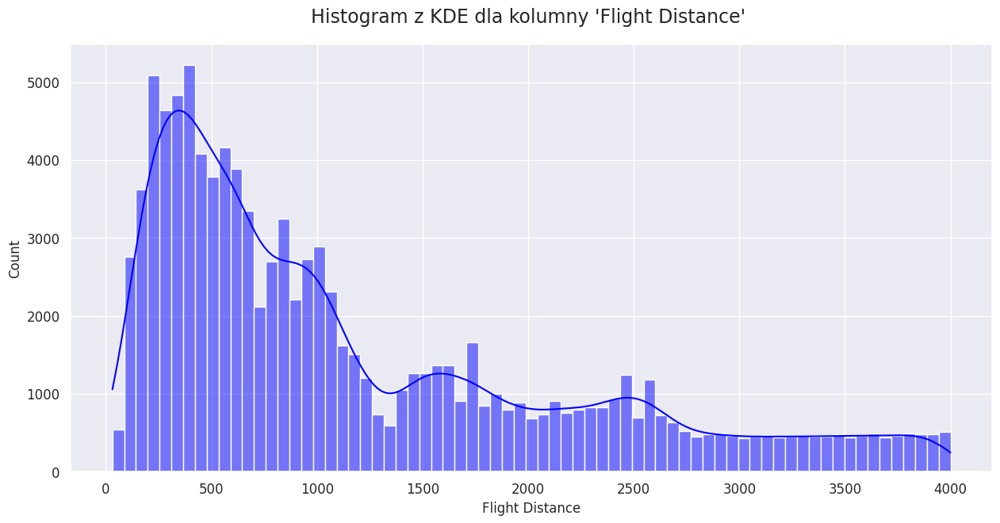

In [ ]:
hist = sns.histplot(data=df, x="Flight Distance", kde=True, color='blue')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title(f"Histogram z KDE dla kolumny 'Flight Distance' ", fontsize=17, pad=20)
plt.show()

### Departure Delay in Minutes

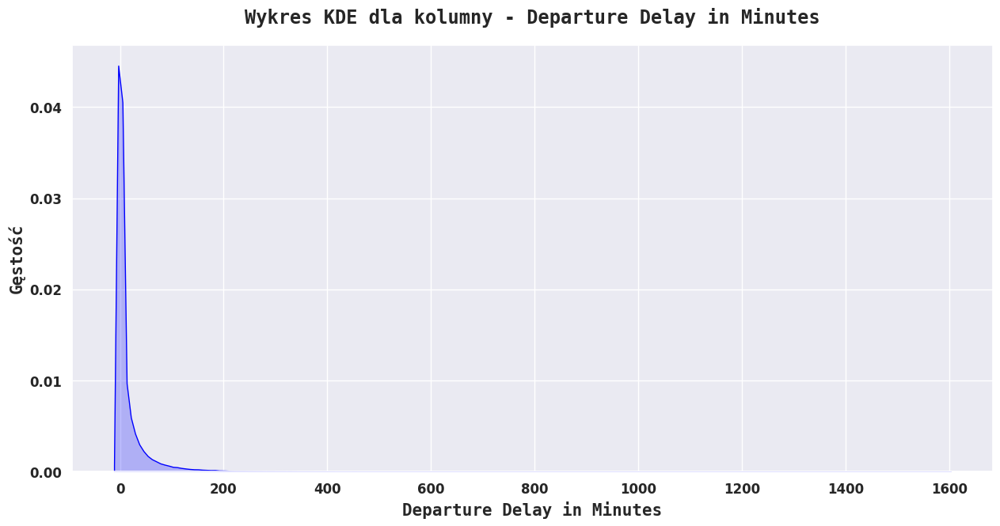

In [ ]:
kde(df, "Departure Delay in Minutes")

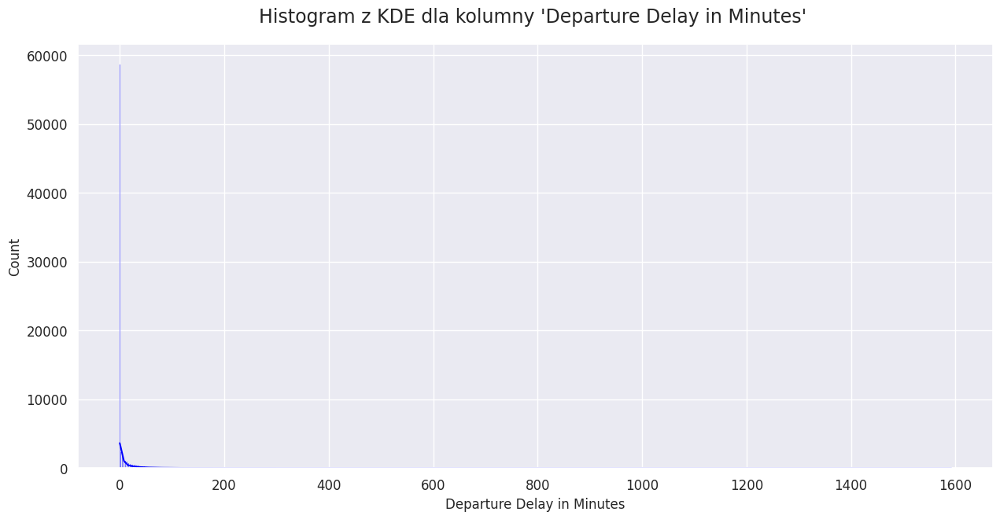

In [ ]:
hist = sns.histplot(data=df, x="Departure Delay in Minutes", kde=True, color='blue')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title(f"Histogram z KDE dla kolumny 'Departure Delay in Minutes' ", fontsize=17, pad=20)
plt.show()

### Arrival Delay in Minutes

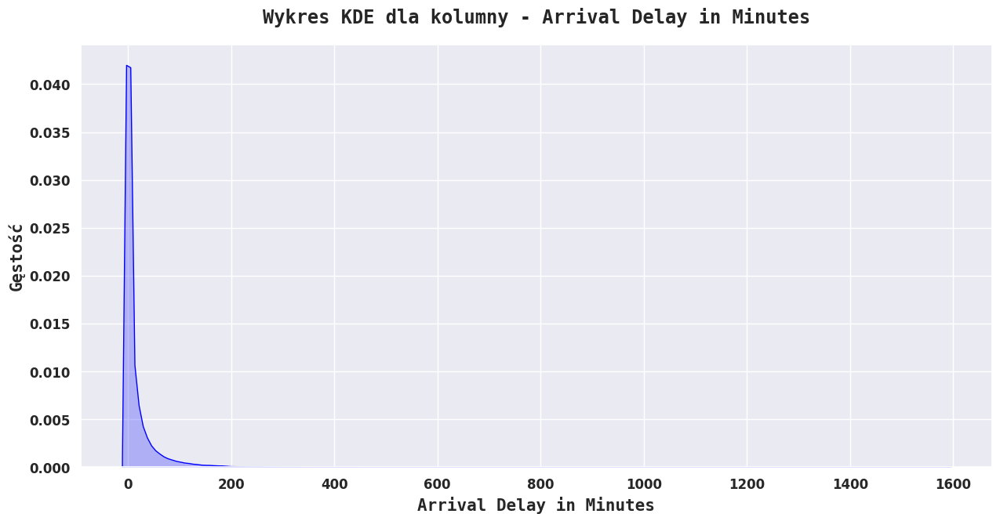

In [ ]:
kde(df, "Arrival Delay in Minutes")

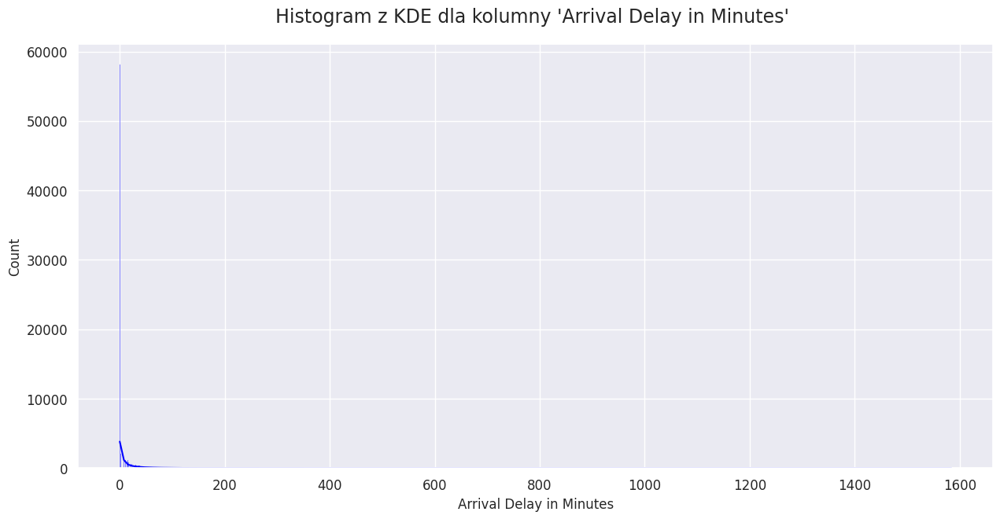

In [ ]:
hist = sns.histplot(data=df, x="Arrival Delay in Minutes", kde=True, color='blue')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title(f"Histogram z KDE dla kolumny 'Arrival Delay in Minutes' ", fontsize=17, pad=20)
plt.show()

### Total Delay in Minutes

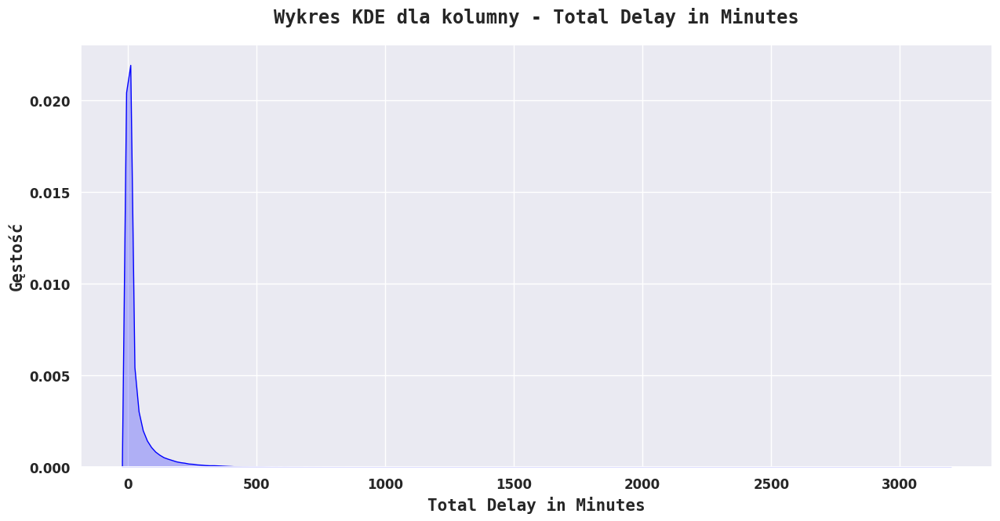

In [ ]:
kde(df, "Total Delay in Minutes")

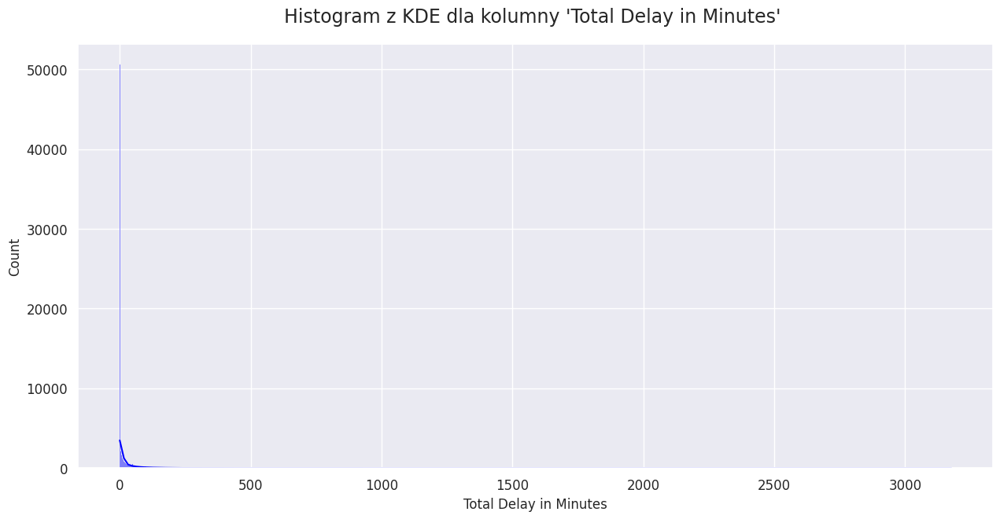

In [ ]:
hist = sns.histplot(data=df, x="Total Delay in Minutes", kde=True, color='blue')

plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.title(f"Histogram z KDE dla kolumny 'Total Delay in Minutes' ", fontsize=17, pad=20)
plt.show()

### Departure and Arrival Time Convenience

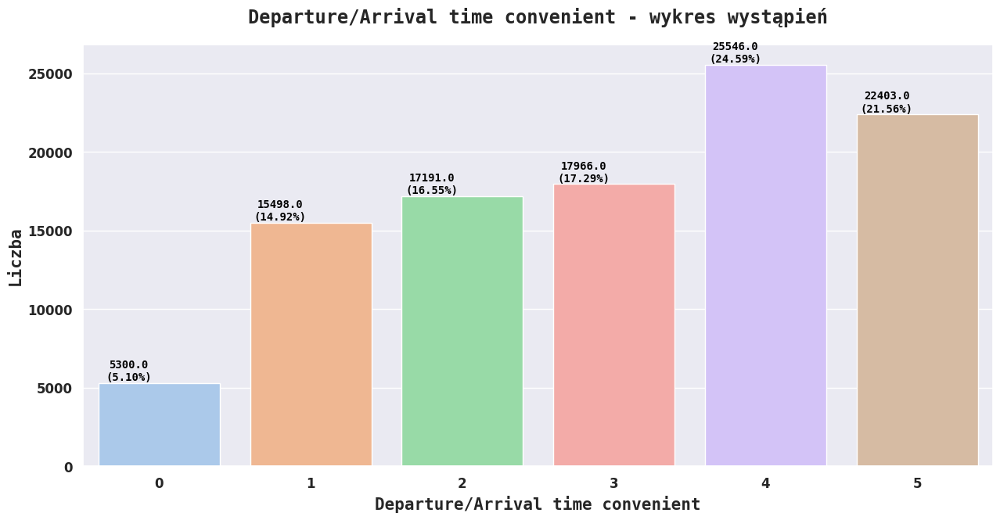

In [ ]:
count(df, "Departure/Arrival time convenient")

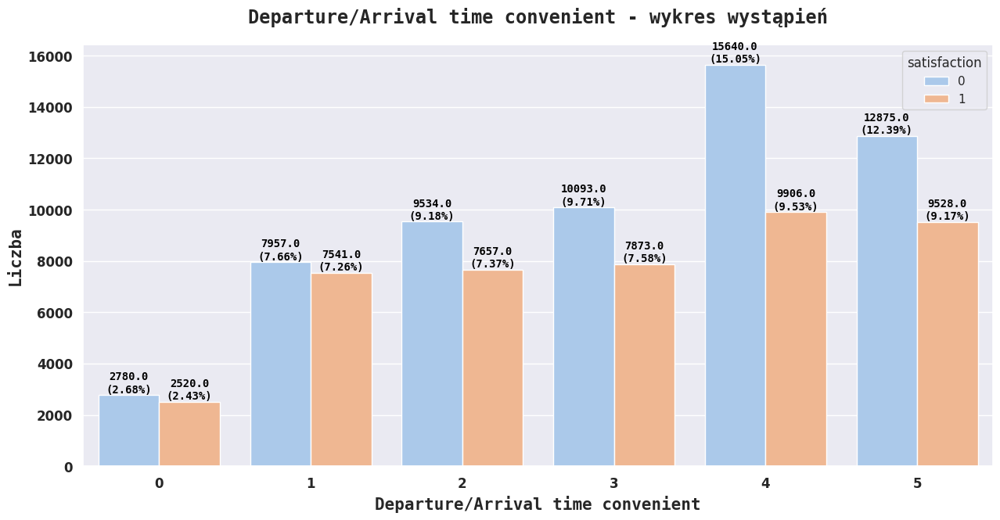

In [ ]:
count(df, "Departure/Arrival time convenient", hue = "satisfaction")

### Services rate

In [ ]:
df.columns

Index(['Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       'Total Delay in Minutes', 'satisfaction'],
      dtype='object')

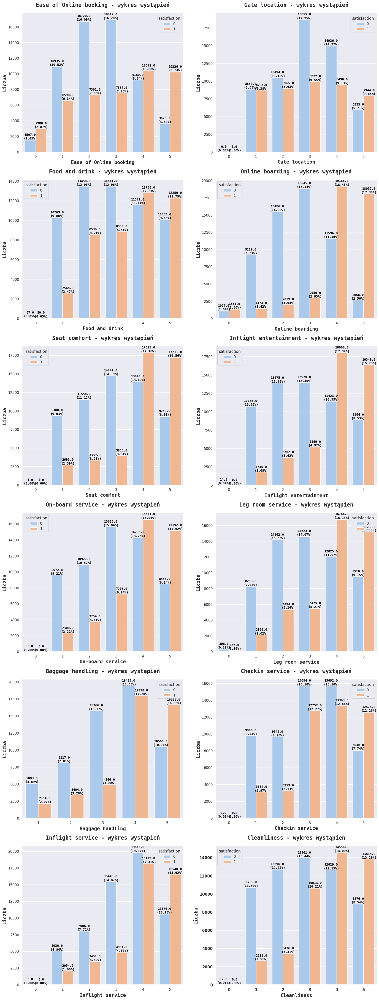

In [ ]:
services = ['Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness']

fig, ax = plt.subplots(6, 2, figsize = (20, 55))

for i, service in enumerate(services):
    count(df, service, hue = "satisfaction", ax = ax[i // 2, i % 2])
plt.show()

# 6. Wczytanie zbioru treningowego i testowego.

In [ ]:
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score,f1_score, confusion_matrix, roc_curve, precision_recall_curve
from sklearn.model_selection import cross_val_predict
from sklearn.base import clone

import itertools

## Zbiór treningowy i testowy


In [ ]:
X_train_full = df1.drop('satisfaction', axis = 1)
y_train_full = df1.satisfaction

X_test = df_test.drop('satisfaction', axis=1)
y_test = df_test.satisfaction

In [ ]:
# Podział na zbiór treningowy i walidacyjny
X_train, X_valid, y_train, y_valid = train_test_split(X_train_full, y_train_full, test_size = 0.2, random_state = 42)

In [ ]:
models, auc_scores = [], [] 

In [ ]:
#Krzywa ROC
def plot_roc_curve(fpr, tpr, label = None):
    plt.plot(fpr, tpr, linewidth = 2, label= label)
    plt.plot([0, 1], [0, 1], "k--")
    plt.xlabel("False Positive Rate", fontname = "monospace", fontsize = 15, weight = "semibold")
    plt.ylabel("True Positive Rate(Recall)", fontname = "monospace", fontsize = 15, weight = "semibold")
    plt.title("ROC Curve", fontname = "monospace", fontsize = 17, weight = "bold")
    plt.axis([0, 1, 0, 1])
    plt.show()


# 7. Uruchomienie modeli dla podstawowych wartości hiperparametrów.

## Regresja Logistyczna (ang. Logistic Reggresion)

In [ ]:
# Definicja i trening klasyfikatora 
log_reg_clf = LogisticRegression(random_state = 42, max_iter = 500)
log_reg_clf.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(max_iter=500, random_state=42)

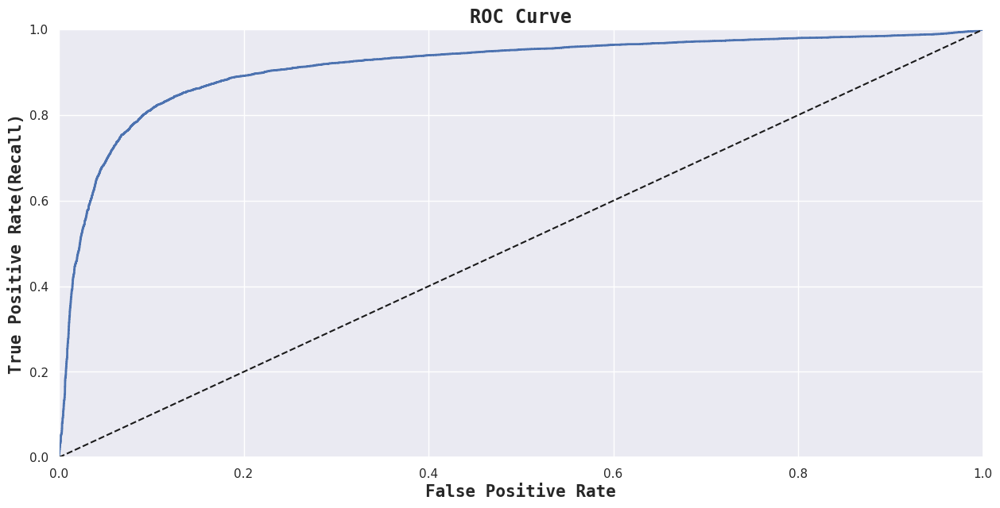

In [ ]:
# Sprawdzenie na zbiorze walidacyjnym 
log_reg_scores = log_reg_clf.decision_function(X_valid)

# wykreślenie krzywej ROC
log_reg_fpr, log_reg_tpr, _ = roc_curve(y_valid, log_reg_scores)
plot_roc_curve(log_reg_fpr, log_reg_tpr)

In [ ]:
# Wyliczenie wartości ROC AUC
log_reg_auc = roc_auc_score(y_valid, log_reg_scores)
log_reg_auc

0.9135536124584709

In [ ]:
# Doadanie nazwy modelu i wyniku do listy
models.append("Logistic Regression")
auc_scores.append(log_reg_auc)

In [ ]:
log_reg_clf.predict_proba(X_test)

array([[0.11838383, 0.88161617],
       [0.39025657, 0.60974343],
       [0.91364829, 0.08635171],
       ...,
       [0.95225428, 0.04774572],
       [0.10332857, 0.89667143],
       [0.99747276, 0.00252724]])

In [ ]:
log_reg_clf.predict_proba(X_test)[:, 1]

array([0.88161617, 0.60974343, 0.08635171, ..., 0.04774572, 0.89667143,
       0.00252724])

Algorytm stochastycznego spadku gradientu (Stochastic Gradient Descent - SGD)

In [ ]:
sgd_clf = SGDClassifier(random_state = 42)
sgd_clf.fit(X_train, y_train)

SGDClassifier(random_state=42)

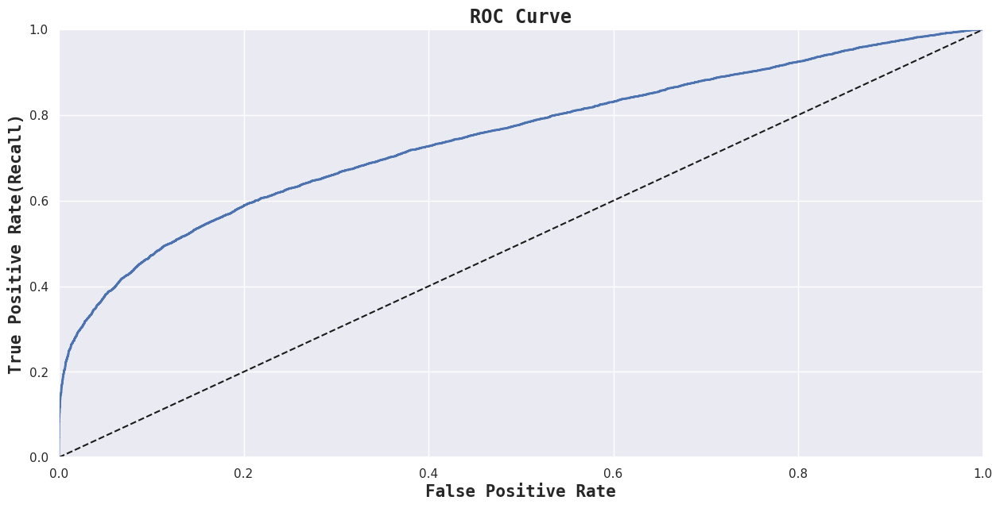

In [ ]:
sgd_clf_scores = sgd_clf.decision_function(X_valid)
sgd_clf_fpr, sgd_clf_tpr, _ = roc_curve(y_valid, sgd_clf_scores)
plot_roc_curve(sgd_clf_fpr, sgd_clf_tpr)

In [ ]:
sgd_auc = roc_auc_score(y_valid, sgd_clf_scores)
sgd_auc

0.7470119142311535

In [ ]:
models.append("SGD Classifier")
auc_scores.append(sgd_auc)

## Las Losowy (ang. Random Forest Classifier)

In [ ]:
forest_clf = RandomForestClassifier(random_state = 42)
forest_clf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
forest_clf_probas = forest_clf.predict_proba(X_valid)
forest_clf_scores = forest_clf_probas[:, 1]

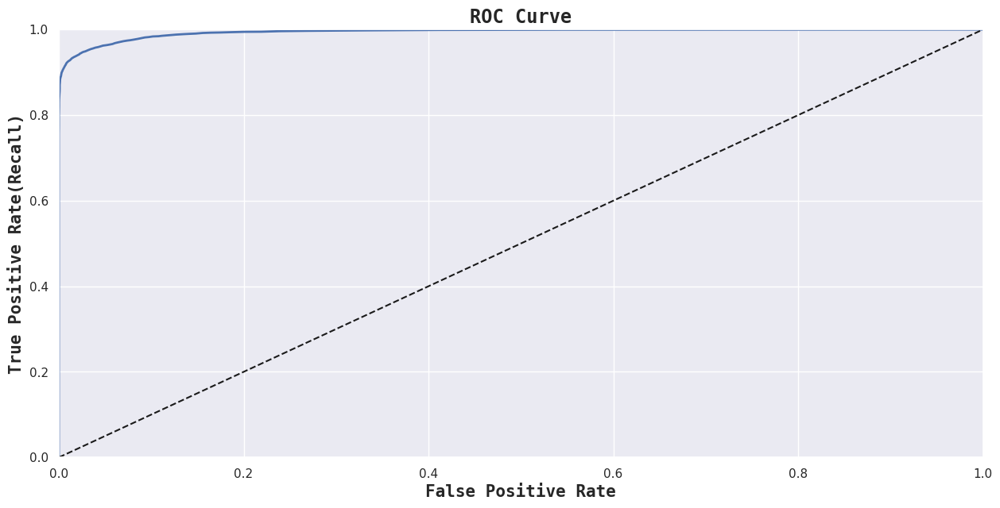

In [ ]:
forest_fpr, forest_tpr, _ = roc_curve(y_valid, forest_clf_scores)
plot_roc_curve(forest_fpr, forest_tpr)

In [ ]:
forest_auc_score = roc_auc_score(y_valid, forest_clf_scores)
forest_auc_score

0.9939780197776018

In [ ]:
models.append("Random Forest")
auc_scores.append(forest_auc_score)

## Maszyna wektorów nośnych (ang. SVC - Support Vector Classifier)



In [ ]:
svm_clf = SVC(random_state = 42, max_iter = 500)
svm_clf.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


SVC(max_iter=500, random_state=42)

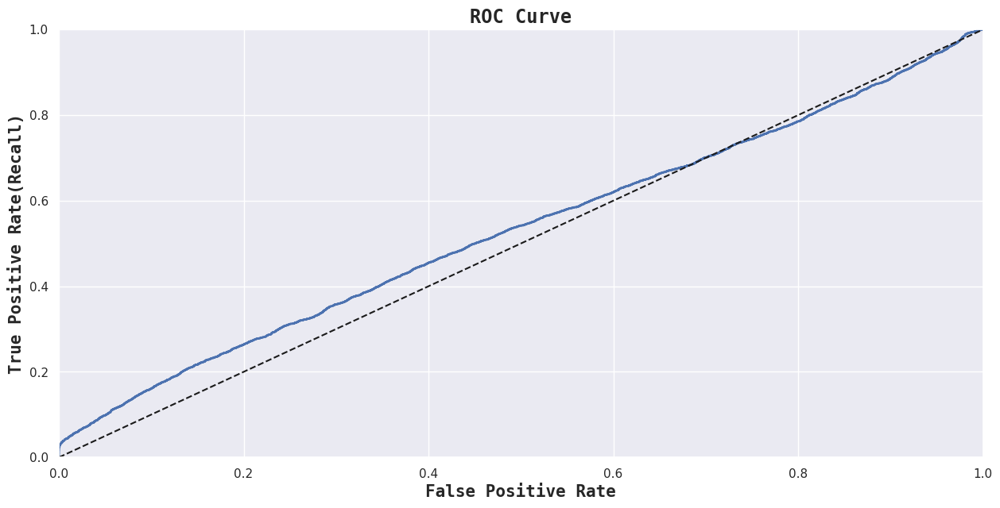

In [ ]:
svm_clf_scores = svm_clf.decision_function(X_valid)
svm_fpr, svm_tpr, _ = roc_curve(y_valid, svm_clf_scores)
plot_roc_curve(svm_fpr, svm_tpr)

In [ ]:
svm_clf_auc = roc_auc_score(y_valid, svm_clf_scores)
svm_clf_auc

0.5292865828598561

In [ ]:
models.append("svm")
auc_scores.append(svm_clf_auc)

## Drzewo Decyzyjne (ang. Decision Tree)

In [ ]:
tree_clf = DecisionTreeClassifier(random_state=42)
tree_clf.fit(X_train, y_train)

In [ ]:
tree_clf_probas = tree_clf.predict_proba(X_valid)
tree_clf_scores = tree_clf_probas[:, 1]

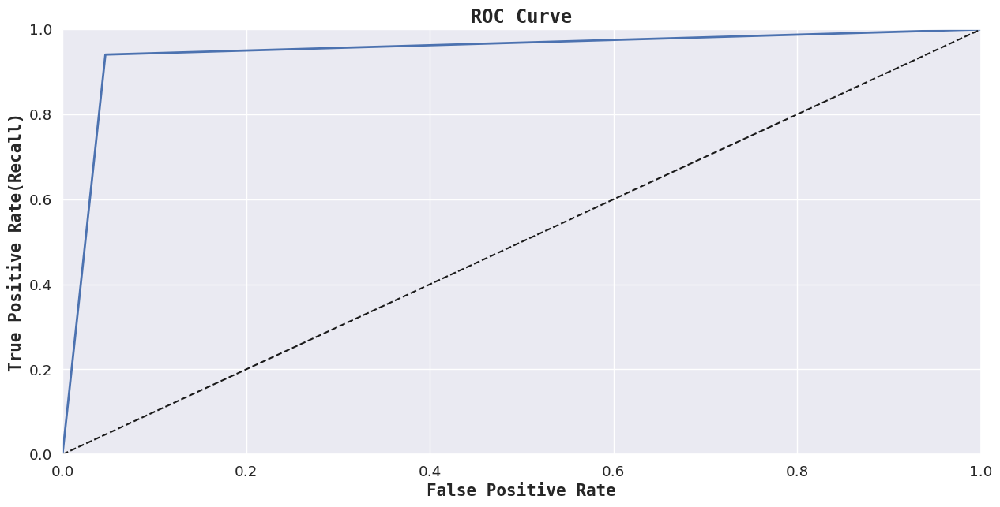

In [ ]:
tree_fpr, tree_tpr, _ = roc_curve(y_valid, tree_clf_scores)
plot_roc_curve(tree_fpr, tree_tpr)

In [ ]:
tree_auc_score = roc_auc_score(y_valid, tree_clf_scores)
tree_auc_score

0.9469851210228637

In [ ]:
models.append("Decision Tree")
auc_scores.append(tree_auc_score)

## Naiwny Bayes (ang. Naive Bayes)

In [ ]:
nb_clf = GaussianNB()
nb_clf.fit(X_train, y_train)

GaussianNB()

In [ ]:
nb_clf_probas = nb_clf.predict_proba(X_valid)
nb_clf_scores = nb_clf_probas[:, 1]

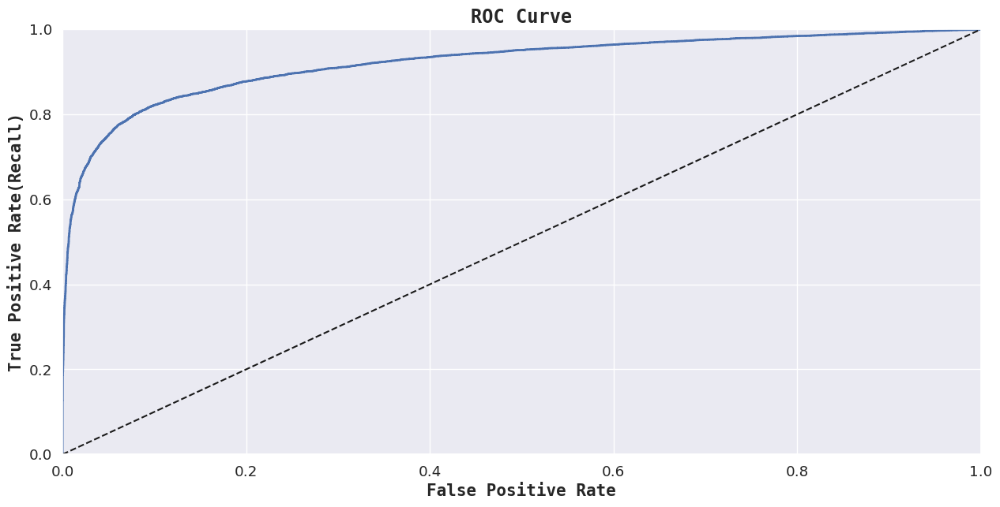

In [ ]:
nb_fpr, nb_tpr, _ = roc_curve(y_valid, nb_clf_scores)
plot_roc_curve(nb_fpr, nb_tpr)

In [ ]:
nb_auc_score = roc_auc_score(y_valid, nb_clf_scores)
nb_auc_score

0.9217701398440147

In [ ]:
models.append("Naive Bayes")
auc_scores.append(nb_auc_score)

## Gradient Boosting

In [ ]:
gb_clf = GradientBoostingClassifier(random_state=42)
gb_clf.fit(X_train, y_train)

GradientBoostingClassifier(random_state=42)

In [ ]:
gb_clf_probas = gb_clf.predict_proba(X_valid)
gb_clf_scores = gb_clf_probas[:, 1]

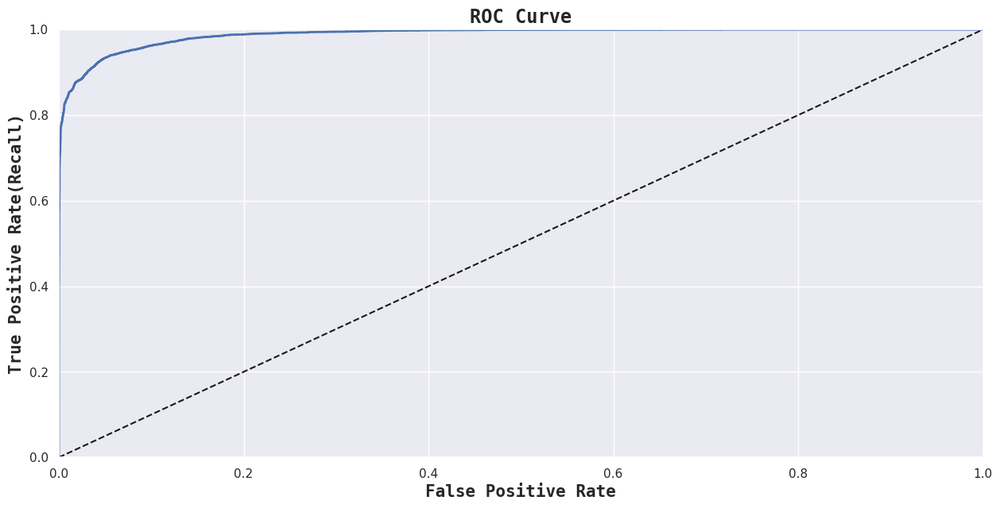

In [ ]:
gb_fpr, gb_tpr, _ = roc_curve(y_valid, gb_clf_scores)
plot_roc_curve(gb_fpr, gb_tpr)

In [ ]:
gb_auc_score = roc_auc_score(y_valid, gb_clf_scores)
gb_auc_score

0.9877568275606137

In [ ]:
models.append("Gradient boosting")
auc_scores.append(gb_auc_score)

# 8. Testy i wyznaczanie metryk dla modeli z podstawowymi wartościami hiperparametrów

In [ ]:
# Przykład użycia funkcji evaluate_model
models_exp = []
auc_scores_exp = []

log_reg_clf = LogisticRegression(random_state = 42, max_iter = 500)
sgd_clf = SGDClassifier(random_state = 42)
forest_clf = RandomForestClassifier(random_state = 42)
svm_clf = SVC(probability=True,random_state = 42, max_iter = 500)
tree_clf = DecisionTreeClassifier(random_state=42)
nb_clf = GaussianNB()
gb_clf = GradientBoostingClassifier(random_state=42)

models_exp = [
    log_reg_clf,
    sgd_clf,
    forest_clf,
    svm_clf,
    tree_clf,
    nb_clf,
    gb_clf
]


LogisticRegression


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy: 0.8577148136741608
Precision: 0.8423811639271435
Recall: 0.8314478645970359
F1 Score: 0.8368788066025243
AUC: 0.9132967153923187
Confusion Matrix:
[[12799  1774]
 [ 1922  9481]]

SGDClassifier


<ipython-input-57-c52ee503f525>:12: RuntimeWarning: overflow encountered in exp
  y_proba = 1 / (1 + np.exp(-decision_scores))


Accuracy: 0.6629196181090237
Precision: 0.9357918999012184
Recall: 0.24923265807243708
F1 Score: 0.393628808864266
AUC: 0.7049011054363417
Confusion Matrix:
[[14378   195]
 [ 8561  2842]]

RandomForestClassifier
Accuracy: 0.9633507853403142
Precision: 0.972853135462854
Recall: 0.9428220643690257
F1 Score: 0.9576022089605415
AUC: 0.9939771237251289
Confusion Matrix:
[[14273   300]
 [  652 10751]]

SVC


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.4499153064367108
Precision: 0.43724995651417636
Recall: 0.8817854950451636
F1 Score: 0.5846100177330736
AUC: 0.4691845934668789
Confusion Matrix:
[[ 1632 12941]
 [ 1348 10055]]

DecisionTreeClassifier
Accuracy: 0.9466430551278103
Precision: 0.9382273164756322
Recall: 0.9403665702008244
F1 Score: 0.9392957252978276
AUC: 0.9459604071754826
Confusion Matrix:
[[13867   706]
 [  680 10723]]

GaussianNB
Accuracy: 0.8567908838928241
Precision: 0.84456005022872
Recall: 0.825747610277997
F1 Score: 0.8350478893224548
AUC: 0.9178696703943007
Confusion Matrix:
[[12840  1733]
 [ 1987  9416]]

GradientBoostingClassifier
Accuracy: 0.9422543886664614
Precision: 0.946040897216467
Recall: 0.9209857055160923
F1 Score: 0.9333451830785638
AUC: 0.9877259712943125
Confusion Matrix:
[[13974   599]
 [  901 10502]]


[]

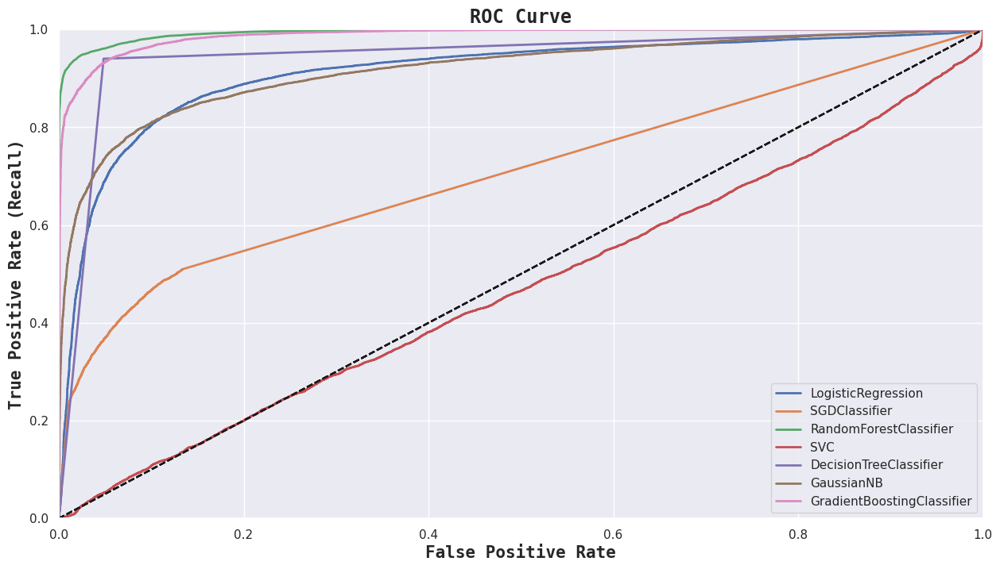

In [ ]:
fig, ax = plt.subplots(figsize=(15, 8))

for model in models_exp:
    print()
    print(model.__class__.__name__, end='\n')

    clf = model
    clf.fit(X_train, y_train)

    if model.__class__.__name__ == 'SGDClassifier':
      decision_scores = clf.decision_function(X_test)
      y_proba = 1 / (1 + np.exp(-decision_scores))
    else:
      y_proba = clf.predict_proba(X_test)[:, 1]

    y_pred = clf.predict(X_test)
    
    fpr, tpr, _ = roc_curve(y_test, y_proba)
    
    ax.plot(fpr, tpr, linewidth = 2,label=model.__class__.__name__)
    ax.plot([0, 1], [0, 1], "k--")
    ax.set_xlabel("False Positive Rate", fontname="monospace", fontsize=15, weight="semibold")
    ax.set_ylabel("True Positive Rate (Recall)", fontname="monospace", fontsize=15, weight="semibold")
    ax.set_title("ROC Curve", fontname="monospace", fontsize=17, weight="bold")
    ax.axis([0, 1, 0, 1])

    # Obliczanie metryk
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_proba)
    confusion_mat = confusion_matrix(y_test, y_pred)

    auc_scores_exp.append(auc)

    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1 Score:", f1)
    print("AUC:",auc)
    print("Confusion Matrix:")
    print(confusion_mat)
    
ax.legend()
ax.plot()

## Najlepszy model dla defaultowych ustawien

In [ ]:
models_exp

[LogisticRegression(max_iter=500, random_state=42),
 SGDClassifier(random_state=42),
 RandomForestClassifier(random_state=42),
 SVC(max_iter=500, probability=True, random_state=42),
 DecisionTreeClassifier(random_state=42),
 GaussianNB(),
 GradientBoostingClassifier(random_state=42)]

In [ ]:
models_exp = pd.DataFrame({"model_name":models_exp, "auc_score": auc_scores_exp})

In [ ]:
models_exp.sort_values("auc_score", ascending = False)

,model_name,auc_score
2,"(DecisionTreeClassifier(max_features='sqrt', r...",0.993977
6,([DecisionTreeRegressor(criterion='friedman_ms...,0.987726
4,DecisionTreeClassifier(random_state=42),0.945960
5,GaussianNB(),0.917870
0,"LogisticRegression(max_iter=500, random_state=42)",0.913297
1,SGDClassifier(random_state=42),0.704901
3,"SVC(max_iter=500, probability=True, random_sta...",0.469185


# 9. Testy dla różnych wartości hiperparametrów.


In [ ]:
models_exp_hipper = []
auc_scores_exp_hipper = []

log_reg_clf = LogisticRegression(random_state = 42, max_iter = 500)
sgd_clf = SGDClassifier(random_state = 42)
forest_clf = RandomForestClassifier(random_state = 42)
svm_clf = SVC(probability=True,random_state = 42, max_iter = 500)
tree_clf = DecisionTreeClassifier(random_state=42)
nb_clf = GaussianNB()
gb_clf = GradientBoostingClassifier(random_state=42)

models_exp_hipper = [
    log_reg_clf,
    sgd_clf,
    forest_clf,
    svm_clf,
    tree_clf,
    nb_clf,
    gb_clf
]

In [ ]:
param_grid = {
    'LogisticRegression': {'max_iter': [100, 500, 1000], 'C': [0.1, 1.0, 10.0]},
    'SGDClassifier': {'max_iter': [100, 500, 1000], 'alpha': [0.0001, 0.001, 0.01]},
    'RandomForestClassifier': {'n_estimators': [100, 200, 500], 'max_depth': [None, 10, 20]},
    'SVC': {'C': [0.1, 1.0, 10.0], 'kernel': ['linear', 'rbf']},
    'DecisionTreeClassifier': {'max_depth': [None, 10, 20], 'min_samples_split': [2, 5, 10]},
    'GaussianNB': {'var_smoothing': [1e-9, 1e-6, 1e-3]},
    'GradientBoostingClassifier': {'n_estimators': [100, 200, 500], 'learning_rate': [0.01, 0.1, 1.0]}
}


LogisticRegression


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8099014474899907
Precision: 0.7647636989106397
Recall: 0.8188196088748575
F1 Score: 0.7908690496357784
AUC: 0.8702349225461482
Confusion Matrix:
[[11701  2872]
 [ 2066  9337]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8102094240837696
Precision: 0.768077528369088
Recall: 0.8132070507761116
F1 Score: 0.7899982961322202
AUC: 0.8706222349821937
Confusion Matrix:
[[11773  2800]
 [ 2130  9273]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8086310440406529
Precision: 0.7615484710474951
Recall: 0.8211874068227659
F1 Score: 0.7902443141060805
AUC: 0.8701685049805561
Confusion Matrix:
[[11641  2932]
 [ 2039  9364]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8552894979981521
Precision: 0.8446969696969697
Recall: 0.8213627992633518
F1 Score: 0.8328664799253035
AUC: 0.9126334544296999
Confusion Matrix:
[[12851  1722]
 [ 2037  9366]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8577148136741608
Precision: 0.8423811639271435
Recall: 0.8314478645970359
F1 Score: 0.8368788066025243
AUC: 0.9132967153923187
Confusion Matrix:
[[12799  1774]
 [ 1922  9481]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8576763165999384
Precision: 0.8392322592005634
Recall: 0.8359203718319741
F1 Score: 0.8375730416062563
AUC: 0.9118867758450608
Confusion Matrix:
[[12747  1826]
 [ 1871  9532]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8686094856790884
Precision: 0.8626543209876543
Recall: 0.8333771814434798
F1 Score: 0.8477630581203444
AUC: 0.9246751390013375
Confusion Matrix:
[[13060  1513]
 [ 1900  9503]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8703418540190946
Precision: 0.8657925885459347
Recall: 0.8339033587652372
F1 Score: 0.8495488251585812
AUC: 0.9252538630461854
Confusion Matrix:
[[13099  1474]
 [ 1894  9509]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8660301817061903
Precision: 0.858799021827733
Recall: 0.8315355608173288
F1 Score: 0.8449474247014793
AUC: 0.922929850022373
Confusion Matrix:
[[13014  1559]
 [ 1921  9482]]


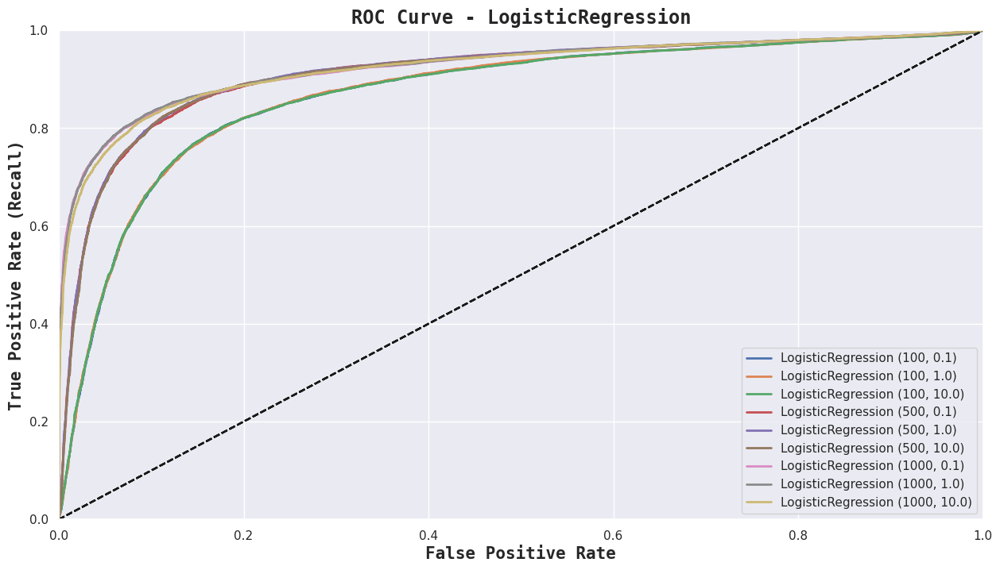


SGDClassifier


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
<ipython-input-60-87bb44f40e3a>:31: RuntimeWarning: overflow encountered in exp
  y_proba = 1 / (1 + np.exp(-decision_scores))
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.7047274407145057
Precision: 0.6083473616996575
Recall: 0.9190563886696483
F1 Score: 0.732099196646874
AUC: 0.7347778200041126
Confusion Matrix:
[[ 7826  6747]
 [  923 10480]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
<ipython-input-60-87bb44f40e3a>:31: RuntimeWarning: overflow encountered in exp
  y_proba = 1 / (1 + np.exp(-decision_scores))
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8390822297505389
Precision: 0.8067091295116773
Recall: 0.8330263965623081
F1 Score: 0.8196565708861852
AUC: 0.8822597575043349
Confusion Matrix:
[[12297  2276]
 [ 1904  9499]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.7491915614413305
Precision: 0.6564861057753874
Recall: 0.8991493466631588
F1 Score: 0.7588912327449021
AUC: 0.8646374598957387
Confusion Matrix:
[[ 9208  5365]
 [ 1150 10253]]


<ipython-input-60-87bb44f40e3a>:31: RuntimeWarning: overflow encountered in exp
  y_proba = 1 / (1 + np.exp(-decision_scores))
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.6629196181090237
Precision: 0.9357918999012184
Recall: 0.24923265807243708
F1 Score: 0.393628808864266
AUC: 0.7049011054363417
Confusion Matrix:
[[14378   195]
 [ 8561  2842]]
Accuracy: 0.8516322759470281
Precision: 0.8544464268945441
Recall: 0.797947908445146
F1 Score: 0.8252312715399964
AUC: 0.9002203562358515
Confusion Matrix:
[[13023  1550]
 [ 2304  9099]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8247998152140438
Precision: 0.9159786304031083
Recall: 0.6615802858896782
F1 Score: 0.768267223382046
AUC: 0.9005105607389479
Confusion Matrix:
[[13881   692]
 [ 3859  7544]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
<ipython-input-60-87bb44f40e3a>:31: RuntimeWarning: overflow encountered in exp
  y_proba = 1 / (1 + np.exp(-decision_scores))
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.6629196181090237
Precision: 0.9357918999012184
Recall: 0.24923265807243708
F1 Score: 0.393628808864266
AUC: 0.7049011054363417
Confusion Matrix:
[[14378   195]
 [ 8561  2842]]
Accuracy: 0.8516322759470281
Precision: 0.8544464268945441
Recall: 0.797947908445146
F1 Score: 0.8252312715399964
AUC: 0.9002203562358515
Confusion Matrix:
[[13023  1550]
 [ 2304  9099]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.8247998152140438
Precision: 0.9159786304031083
Recall: 0.6615802858896782
F1 Score: 0.768267223382046
AUC: 0.9005105607389479
Confusion Matrix:
[[13881   692]
 [ 3859  7544]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


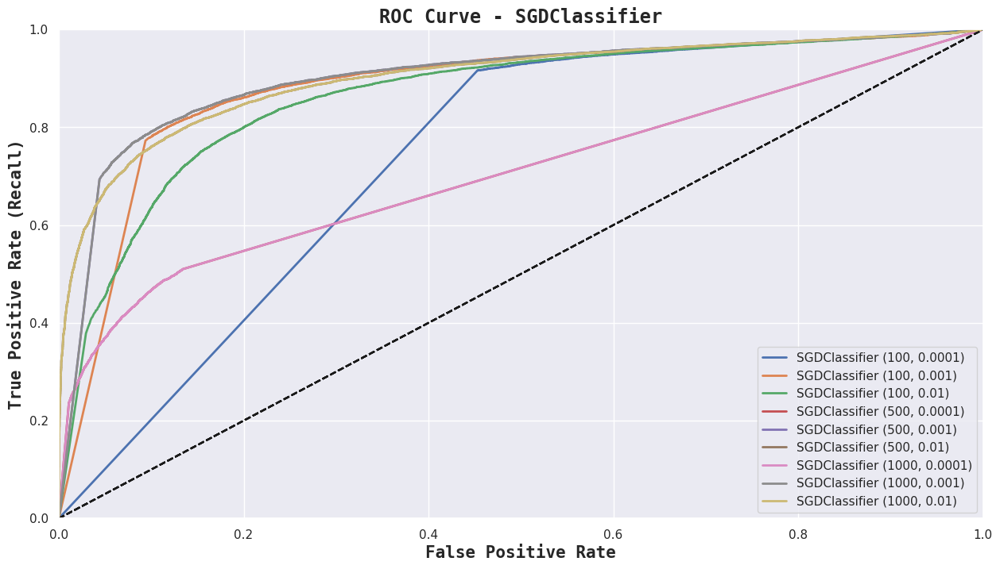


RandomForestClassifier
Accuracy: 0.9633507853403142
Precision: 0.972853135462854
Recall: 0.9428220643690257
F1 Score: 0.9576022089605415
AUC: 0.9939771237251289
Confusion Matrix:
[[14273   300]
 [  652 10751]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9492608561749307
Precision: 0.9481027281613792
Recall: 0.9356309743050074
F1 Score: 0.9418255649717513
AUC: 0.990534506988344
Confusion Matrix:
[[13989   584]
 [  734 10669]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9628118263012011
Precision: 0.9721342621912603
Recall: 0.9422958870472683
F1 Score: 0.9569825436408979
AUC: 0.9938422094719993
Confusion Matrix:
[[14265   308]
 [  658 10745]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9631967970434246
Precision: 0.973100262657368
Recall: 0.9422081908269754
F1 Score: 0.9574050971306363
AUC: 0.9941248918262339
Confusion Matrix:
[[14276   297]
 [  659 10744]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9495303356944872
Precision: 0.9474991131606952
Recall: 0.936946417609401
F1 Score: 0.9421932183958728
AUC: 0.9906021702217876
Confusion Matrix:
[[13981   592]
 [  719 10684]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9633507853403142
Precision: 0.972254857659286
Recall: 0.943435937911076
F1 Score: 0.9576286273811643
AUC: 0.9939992388427833
Confusion Matrix:
[[14266   307]
 [  645 10758]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.963543270711426
Precision: 0.9728654124457308
Recall: 0.9432605454704902
F1 Score: 0.9578342757914421
AUC: 0.9941301272418417
Confusion Matrix:
[[14273   300]
 [  647 10756]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9492608561749307
Precision: 0.9466737532110905
Recall: 0.9372095062702798
F1 Score: 0.9419178565133087
AUC: 0.990605606339388
Confusion Matrix:
[[13971   602]
 [  716 10687]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9628888204496459
Precision: 0.9717126073203796
Recall: 0.9429097605893186
F1 Score: 0.9570945344489941
AUC: 0.9940758323713559
Confusion Matrix:
[[14260   313]
 [  651 10752]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


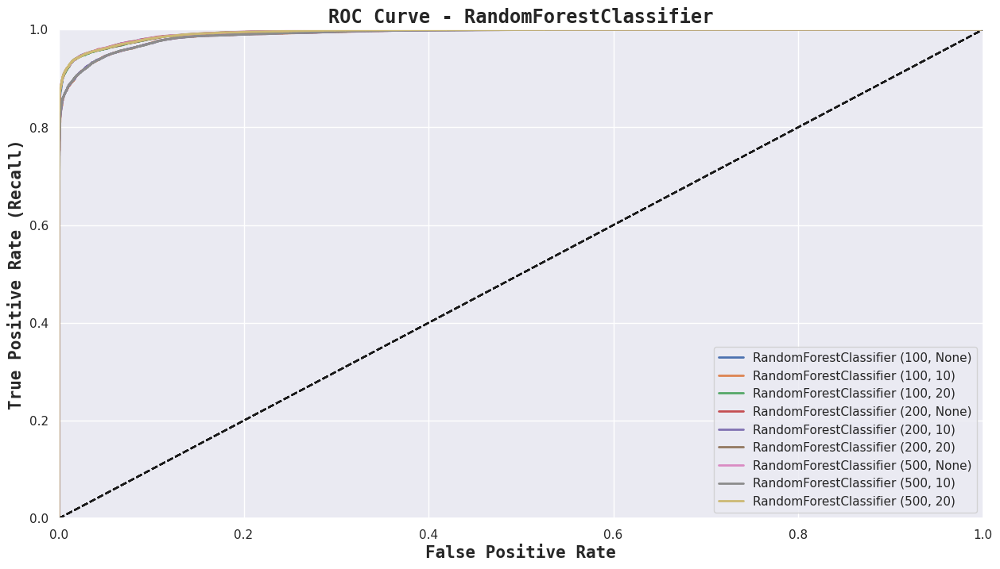


SVC


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.6437865722205113
Precision: 0.7068103116583301
Recall: 0.32219591335613434
F1 Score: 0.4426239383169688
AUC: 0.34270634002030104
Confusion Matrix:
[[13049  1524]
 [ 7729  3674]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.4499153064367108
Precision: 0.43724995651417636
Recall: 0.8817854950451636
F1 Score: 0.5846100177330736
AUC: 0.4691845934668789
Confusion Matrix:
[[ 1632 12941]
 [ 1348 10055]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.3594856790883893
Precision: 0.3734100691589689
Recall: 0.6771025168815225
F1 Score: 0.481359102244389
AUC: 0.36275100726237
Confusion Matrix:
[[ 1617 12956]
 [ 3682  7721]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.4499153064367108
Precision: 0.43724995651417636
Recall: 0.8817854950451636
F1 Score: 0.5846100177330736
AUC: 0.4691845934668789
Confusion Matrix:
[[ 1632 12941]
 [ 1348 10055]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.3594856790883893
Precision: 0.3734100691589689
Recall: 0.6771025168815225
F1 Score: 0.481359102244389
AUC: 0.36272238999923934
Confusion Matrix:
[[ 1617 12956]
 [ 3682  7721]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Accuracy: 0.4499153064367108
Precision: 0.43724995651417636
Recall: 0.8817854950451636
F1 Score: 0.5846100177330736
AUC: 0.4691845934668789
Confusion Matrix:
[[ 1632 12941]
 [ 1348 10055]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


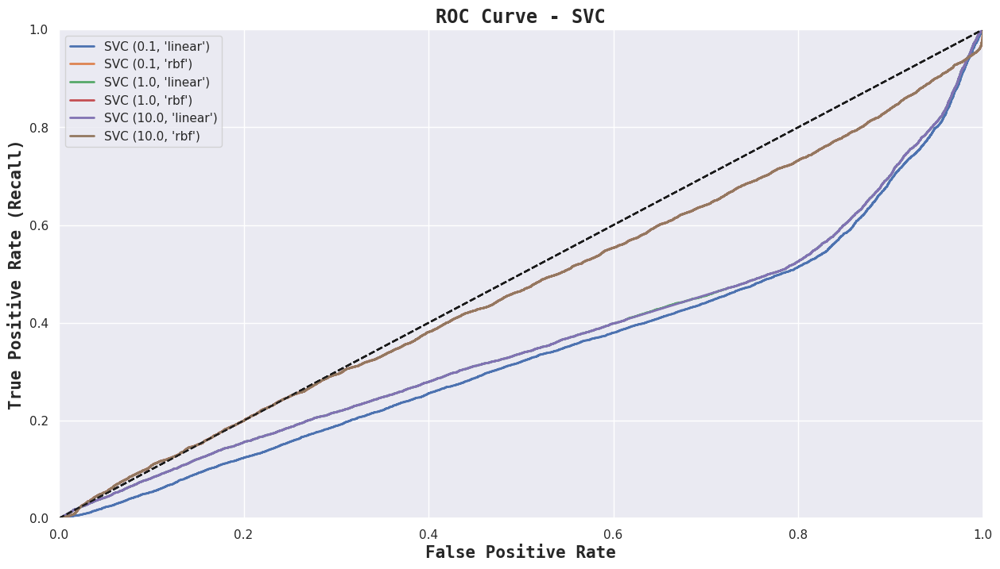


DecisionTreeClassifier
Accuracy: 0.9466430551278103
Precision: 0.9382273164756322
Recall: 0.9403665702008244
F1 Score: 0.9392957252978276
AUC: 0.9459604071754826
Confusion Matrix:
[[13867   706]
 [  680 10723]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9462195873113644
Precision: 0.9385518934081346
Recall: 0.9389634306761379
F1 Score: 0.938757616939196
AUC: 0.9540803051012464
Confusion Matrix:
[[13872   701]
 [  696 10707]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9475669849091469
Precision: 0.9429201588001764
Recall: 0.9372972024905727
F1 Score: 0.9401002726712993
AUC: 0.9658148603348479
Confusion Matrix:
[[13926   647]
 [  715 10688]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.944371727748691
Precision: 0.9518148820326678
Recall: 0.9198456546522845
F1 Score: 0.935557240333586
AUC: 0.9869527635950669
Confusion Matrix:
[[14042   531]
 [  914 10489]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9443332306744687
Precision: 0.9526320574597691
Recall: 0.9188809962290625
F1 Score: 0.9354521917685921
AUC: 0.9874936151248244
Confusion Matrix:
[[14052   521]
 [  925 10478]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9445642131198029
Precision: 0.9521648361622946
Recall: 0.9199333508725774
F1 Score: 0.935771632471008
AUC: 0.9874684761033277
Confusion Matrix:
[[14046   527]
 [  913 10490]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9489528795811518
Precision: 0.9447435784270456
Recall: 0.9386126457949663
F1 Score: 0.9416681330283301
AUC: 0.9559173372165917
Confusion Matrix:
[[13947   626]
 [  700 10703]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9497613181398213
Precision: 0.9474477135767458
Recall: 0.9375602911514513
F1 Score: 0.9424780711420637
AUC: 0.9628350964618405
Confusion Matrix:
[[13980   593]
 [  712 10691]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9493378503233755
Precision: 0.9477936606587943
Recall: 0.9361571516267649
F1 Score: 0.9419394688079061
AUC: 0.9712923296666107
Confusion Matrix:
[[13985   588]
 [  728 10675]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


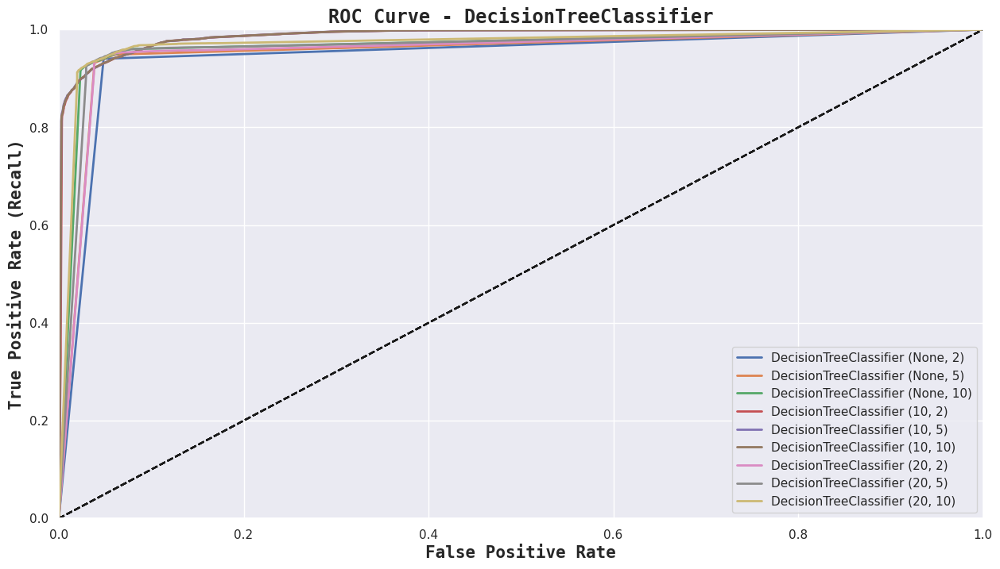


GaussianNB
Accuracy: 0.8567908838928241
Precision: 0.84456005022872
Recall: 0.825747610277997
F1 Score: 0.8350478893224548
AUC: 0.9178696703943007
Confusion Matrix:
[[12840  1733]
 [ 1987  9416]]
Accuracy: 0.8151370495842316
Precision: 0.7715790339833786
Recall: 0.8223274576865737
F1 Score: 0.7961453557480047
AUC: 0.8909513718410668
Confusion Matrix:
[[11797  2776]
 [ 2026  9377]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({
<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.6624576532183554
Precision: 0.6798634812286689
Recall: 0.43672717705866876
F1 Score: 0.531824006834686
AUC: 0.677632936695238
Confusion Matrix:
[[12228  2345]
 [ 6423  4980]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


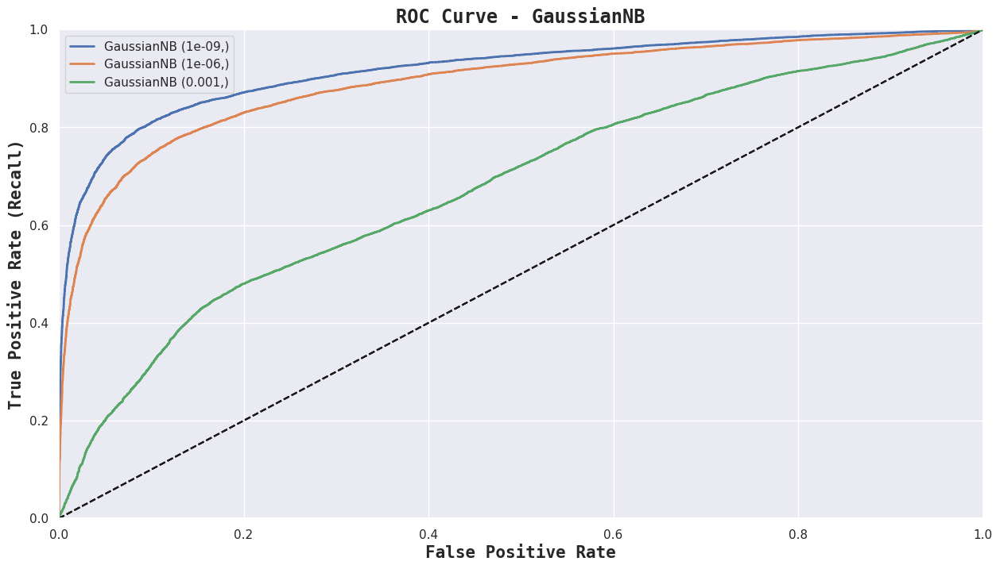


GradientBoostingClassifier
Accuracy: 0.9010240221743148
Precision: 0.8921150772509323
Recall: 0.8810839252828203
F1 Score: 0.88656518861681
AUC: 0.9663786393743368
Confusion Matrix:
[[13358  1215]
 [ 1356 10047]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9422543886664614
Precision: 0.946040897216467
Recall: 0.9209857055160923
F1 Score: 0.9333451830785638
AUC: 0.9877259712943125
Confusion Matrix:
[[13974   599]
 [  901 10502]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9583846627656298
Precision: 0.9628699551569506
Recall: 0.9415066210646321
F1 Score: 0.9520684609586307
AUC: 0.9929731756139708
Confusion Matrix:
[[14159   414]
 [  667 10736]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9066830920850015
Precision: 0.905299268755078
Recall: 0.8794176970972551
F1 Score: 0.892170818505338
AUC: 0.9725461755984031
Confusion Matrix:
[[13524  1049]
 [ 1375 10028]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9523021250384971
Precision: 0.9589956647398844
Recall: 0.9311584670700693
F1 Score: 0.9448720800889878
AUC: 0.9912819407967288
Confusion Matrix:
[[14119   454]
 [  785 10618]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9589621188789652
Precision: 0.9620920876173447
Recall: 0.9436990265719547
F1 Score: 0.9528068000708341
AUC: 0.9930257524256568
Confusion Matrix:
[[14149   424]
 [  642 10761]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9349399445642131
Precision: 0.936774889828222
Recall: 0.9134438305709024
F1 Score: 0.9249622591244118
AUC: 0.983094295389454
Confusion Matrix:
[[13870   703]
 [  987 10416]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9597320603634124
Precision: 0.9680072300045187
Recall: 0.9393142155573094
F1 Score: 0.9534448994124978
AUC: 0.9936610069236326
Confusion Matrix:
[[14219   354]
 [  692 10711]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


Accuracy: 0.9571527563905143
Precision: 0.9575773745997865
Recall: 0.9442252038937122
F1 Score: 0.9508544178036825
AUC: 0.992154320506571
Confusion Matrix:
[[14096   477]
 [  636 10767]]


<ipython-input-60-87bb44f40e3a>:63: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  metrics_df = metrics_df.append({


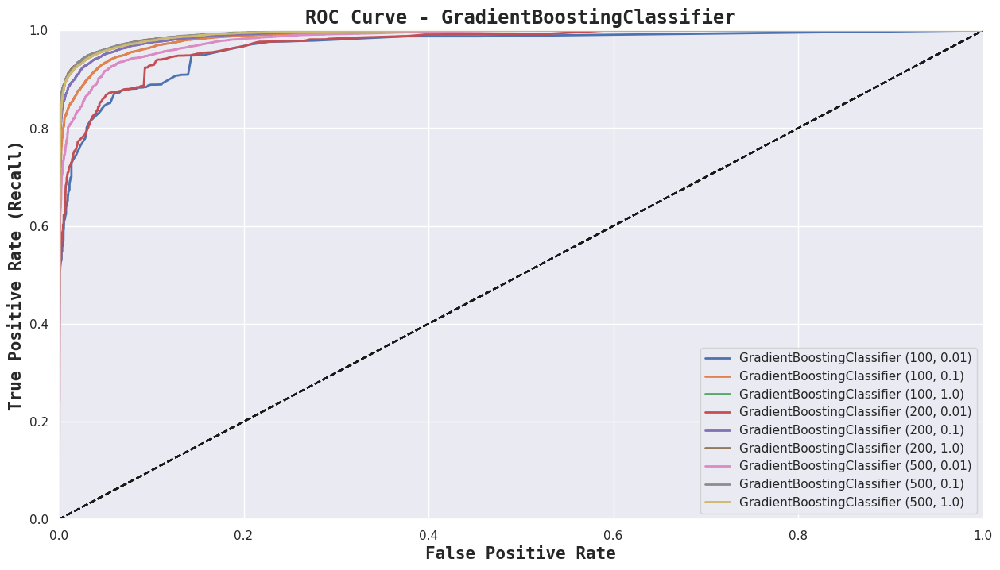

                                     Model  Accuracy  Precision    Recall  \
0            LogisticRegression (100, 0.1)  0.809901   0.764764  0.818820   
1            LogisticRegression (100, 1.0)  0.810209   0.768078  0.813207   
2           LogisticRegression (100, 10.0)  0.808631   0.761548  0.821187   
3            LogisticRegression (500, 0.1)  0.855289   0.844697  0.821363   
4            LogisticRegression (500, 1.0)  0.857715   0.842381  0.831448   
5           LogisticRegression (500, 10.0)  0.857676   0.839232  0.835920   
6           LogisticRegression (1000, 0.1)  0.868609   0.862654  0.833377   
7           LogisticRegression (1000, 1.0)  0.870342   0.865793  0.833903   
8          LogisticRegression (1000, 10.0)  0.866030   0.858799  0.831536   
9              SGDClassifier (100, 0.0001)  0.704727   0.608347  0.919056   
10              SGDClassifier (100, 0.001)  0.839082   0.806709  0.833026   
11               SGDClassifier (100, 0.01)  0.749192   0.656486  0.899149   

In [ ]:
# Utwórz pustą ramkę danych do przechowywania metryk
metrics_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC'])

# Iteruj przez modele
for model in models_exp_hipper:
    print()
    print(model.__class__.__name__, end='\n')

    # Pobierz nazwę modelu
    model_name = model.__class__.__name__

    # Sprawdź, czy dla danego modelu istnieją hiperparametry w param_grid
    if model_name in param_grid:
        # Pobierz zestaw hiperparametrów dla danego modelu
        hyperparameters = param_grid[model_name]

        fig, ax = plt.subplots(figsize=(15, 8))

        # Utwórz wszystkie możliwe kombinacje hiperparametrów
        param_combinations = itertools.product(*hyperparameters.values())

        for params in param_combinations:
            # Utwórz kopię modelu i ustaw hiperparametry
            clf = clone(model)
            clf.set_params(**dict(zip(hyperparameters.keys(), params)))

            clf.fit(X_train, y_train)

            if model_name == 'SGDClassifier':
                decision_scores = clf.decision_function(X_test)
                y_proba = 1 / (1 + np.exp(-decision_scores))
            else:
                y_proba = clf.predict_proba(X_test)[:, 1]

            y_pred = clf.predict(X_test)

            fpr, tpr, _ = roc_curve(y_test, y_proba)

            ax.plot(fpr, tpr, linewidth=2, label=f"{model_name} {params}")
            ax.plot([0, 1], [0, 1], "k--")
            ax.set_xlabel("False Positive Rate", fontname="monospace", fontsize=15, weight="semibold")
            ax.set_ylabel("True Positive Rate (Recall)", fontname="monospace", fontsize=15, weight="semibold")
            ax.set_title("ROC Curve - " + model_name, fontname="monospace", fontsize=17, weight="bold")
            ax.axis([0, 1, 0, 1])

            # Obliczanie metryk
            accuracy = accuracy_score(y_test, y_pred)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            auc = roc_auc_score(y_test, y_proba)
            confusion_mat = confusion_matrix(y_test, y_pred)

            print("Accuracy:", accuracy)
            print("Precision:", precision)
            print("Recall:", recall)
            print("F1 Score:", f1)
            print("AUC:", auc)
            print("Confusion Matrix:")
            print(confusion_mat)

            # Dodaj metryki do ramki danych
            metrics_df = metrics_df.append({
                'Model': f"{model_name} {params}",
                'Accuracy': accuracy,
                'Precision': precision,
                'Recall': recall,
                'F1 Score': f1,
                'AUC': auc
            }, ignore_index=True)

        ax.legend()
        plt.show()
    else:
        clf = model
        clf.fit(X_train, y_train)

        fig, ax = plt.subplots(figsize=(15, 8))

        if model_name == 'SGDClassifier':
            decision_scores = clf.decision_function(X_test)
            y_proba = 1 / (1 + np.exp(-decision_scores))
        else:
            y_proba = clf.predict_proba(X_test)[:, 1]

        y_pred = clf.predict(X_test)

        fpr, tpr, _ = roc_curve(y_test, y_proba)

        ax.plot(fpr, tpr, linewidth=2, label=model_name)
        ax.plot([0, 1], [0, 1], "k--")
        ax.set_xlabel("False Positive Rate", fontname="monospace", fontsize=15, weight="semibold")
        ax.set_ylabel("True Positive Rate (Recall)", fontname="monospace", fontsize=15, weight="semibold")
        ax.set_title("ROC Curve - " + model_name, fontname="monospace", fontsize=17, weight="bold")
        ax.axis([0, 1, 0, 1])

        # Obliczanie metryk
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        auc = roc_auc_score(y_test, y_proba)
        confusion_mat = confusion_matrix(y_test, y_pred)

        print("Accuracy:", accuracy)
        print("Precision:", precision)
        print("Recall:", recall)
        print("F1 Score:", f1)
        print("AUC:", auc)
        print("Confusion Matrix:")
        print(confusion_mat)

        # Dodaj metryki do ramki danych
        metrics_df = metrics_df.append({
            'Model': model_name,
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': f1,
            'AUC': auc
        }, ignore_index=True)

        ax.legend()
        plt.show()

# Wyświetl ramkę danych z metrykami
print(metrics_df)

In [ ]:
metrics_df.sort_values("AUC", ascending = False)

,Model,Accuracy,Precision,Recall,F1 Score,AUC
24,"RandomForestClassifier (500, None)",0.963543,0.972865,0.943261,0.957834,0.994130
21,"RandomForestClassifier (200, None)",0.963197,0.973100,0.942208,0.957405,0.994125
26,"RandomForestClassifier (500, 20)",0.962889,0.971713,0.942910,0.957095,0.994076
23,"RandomForestClassifier (200, 20)",0.963351,0.972255,0.943436,0.957629,0.993999
18,"RandomForestClassifier (100, None)",0.963351,0.972853,0.942822,0.957602,0.993977
20,"RandomForestClassifier (100, 20)",0.962812,0.972134,0.942296,0.956983,0.993842
52,"GradientBoostingClassifier (500, 0.1)",0.959732,0.968007,0.939314,0.953445,0.993661
50,"GradientBoostingClassifier (200, 1.0)",0.958962,0.962092,0.943699,0.952807,0.993026
47,"GradientBoostingClassifier (100, 1.0)",0.958385,0.962870,0.941507,0.952068,0.992973
53,"GradientBoostingClassifier (500, 1.0)",0.957153,0.957577,0.944225,0.950854,0.992154


* df -> zbiór danych do analizy (przed kodowaniem)
* df1 -> zbiór danych do treningu (po kodowaniu)
* df_test -> zbiór danych testowych (po kodowaniu)